# Analysis of basic municipality statistics and migration

Here we characterize arrival and departure municipalities by years.

In [1]:
import warnings
warnings.filterwarnings('ignore', category=FutureWarning)

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import geopandas as gpd
import copy
import pickle

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

from geopy.geocoders import Nominatim
from geopy.distance import geodesic

from matplotlib.collections import LineCollection
import matplotlib.colors as mcolors

from matplotlib.colors import LogNorm

from plotly.subplots import make_subplots
from d3blocks import D3Blocks

In [2]:
mun_stats = pd.read_csv("data/statfin_vaerak_pxt_11ra_municipalities.csv", index_col=0)
mun_migri = pd.read_csv("data/statfin_muutl_pxt_11a1_municipalities.csv", index_col=0)

Print first few rows to see how the municipality and migration data look like.

In [3]:
mun_stats.head()

,Area,Information,1990,1991,1992,1993,1994,1995,1996,1997,...,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024
0,Akaa,Population 31 Dec,16048.0,16096.0,16201.0,16142.0,16038.0,15986.0,15924.0,15840.0,...,17043.0,16923.0,16769.0,16611.0,16475.0,16391.0,16467.0,16473.0,16405.0,16387.0
1,Akaa,Increase of population,111.0,48.0,105.0,-59.0,-104.0,-52.0,-62.0,-84.0,...,-9.0,-120.0,-154.0,-158.0,-136.0,-84.0,76.0,6.0,-68.0,-18.0
2,Akaa,"Increase of population, %",0.7,0.3,0.7,-0.4,-0.6,-0.3,-0.4,-0.5,...,-0.1,-0.7,-0.9,-0.9,-0.8,-0.5,0.5,0.0,-0.4,-0.1
3,Akaa,"Share of persons aged under 15, %",18.5,18.5,18.8,18.6,18.9,18.7,18.6,18.3,...,18.5,18.3,18.0,17.7,17.2,16.5,16.3,15.7,15.3,15.0
4,Akaa,"Share of persons aged 15 to 64, %",65.7,65.5,65.2,65.0,64.4,64.3,64.2,64.4,...,60.5,60.2,59.8,59.4,59.3,59.3,58.9,58.9,59.1,59.2


In [4]:
has_na = mun_stats.iloc[:, 2:].isna().sum()
has_na[has_na > 0].index

Index(['2024'], dtype='object')

In [5]:
missing_stats = \
    (mun_stats[['Area', 'Information', '2024']].groupby(['Area', 'Information'])['2024']
     .apply(lambda x: x.isna().sum()).reset_index(name='MissingCount'))

missing_stats[missing_stats['MissingCount'] > 0]['Information'].unique()

array(['Economic dependency ratio',
       'Share of persons in inner urban area, %',
       'Share of persons in local centres in rural areas, %',
       'Share of persons in outer urban area, %',
       'Share of persons in peri-urban area, %',
       'Share of persons in rural areas close to urban areas, %',
       'Share of persons in rural areas, %',
       'Share of persons in rural heartland areas, %',
       'Share of persons in sparsely populated rural areas, %',
       'Share of persons in urban areas, %'], dtype=object)

In [6]:
mun_stats['Information'].nunique()

43

In [7]:
mun_migri.head()

,Area of arrival,Area of departure,Males 1990 Intermunicipal migration,Males 1991 Intermunicipal migration,Males 1992 Intermunicipal migration,Males 1993 Intermunicipal migration,Males 1994 Intermunicipal migration,Males 1995 Intermunicipal migration,Males 1996 Intermunicipal migration,Males 1997 Intermunicipal migration,...,Females 2014 Intermunicipal migration,Females 2015 Intermunicipal migration,Females 2016 Intermunicipal migration,Females 2017 Intermunicipal migration,Females 2018 Intermunicipal migration,Females 2019 Intermunicipal migration,Females 2020 Intermunicipal migration,Females 2021 Intermunicipal migration,Females 2022 Intermunicipal migration,Females 2023 Intermunicipal migration
0,Arrival - Akaa,Departure - Akaa,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Arrival - Akaa,Departure - Alajärvi,0,0,0,1,1,0,0,0,...,0,1,0,1,0,0,0,1,0,0
2,Arrival - Akaa,Departure - Alavieska,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,Arrival - Akaa,Departure - Alavus,0,0,0,0,0,0,1,0,...,0,0,0,0,3,0,0,0,0,0
4,Arrival - Akaa,Departure - Asikkala,0,0,0,0,1,0,0,0,...,0,1,0,0,0,0,0,0,1,0


In [8]:
has_na = mun_migri.iloc[:, 2:].isna().sum()
has_na[has_na > 0].index

Index([], dtype='object')

Then let's see how the population is distributed by municipality.

In [9]:
pop_stats = \
    (mun_stats
     .loc[mun_stats["Information"] == "Population 31 Dec", :]
     .melt(
        id_vars=["Area", "Information"],
        var_name="year",
        value_name="Population 31 Dec")
     .drop(columns=["Information"])
     .pivot(columns="Area", index="year")
     # .astype('int')
     .describe())

In [10]:
# select with min population >10000

pop_stats.loc[:, (pop_stats.loc[["min"]] > 10000).values[0]]

Population 31 Dec                                             \
Area               Akaa        Alavus          Espoo          Eura   
count         35.000000     35.000000      35.000000     35.000000   
mean       16444.142857  12553.457143  240115.057143  12553.714286   
std          412.816164    878.551192   42196.743742    733.818641   
min        15840.000000  10780.000000  172629.000000  11084.000000   
25%        16072.000000  11975.500000  207314.500000  12066.000000   
50%        16405.000000  12788.000000  238047.000000  12676.000000   
75%        16803.000000  13236.500000  272192.500000  13169.500000   
max        17134.000000  13785.000000  320931.000000  13533.000000   

                                                                              \
Area         Forssa        Hamina       Heinola       Helsinki       Hollola   
count     35.000000     35.000000     35.000000      35.000000     35.000000   
mean   18051.057143  21378.428571  20394.400000  583561.714286  23185.742857   
std     1027.320814    990.609209   1352.502217   55133.414754    617.920485   
min    16459.000000  19311.000000  17829.000000  492400.000000  22236.000000   
25%    17377.000000  20743.500000  19462.500000  548720.000000  22626.000000   
50%    17894.000000  21705.000000  20604.000000  568531.000000  23090.000000   
75%    18750.500000  22059.500000  21459.000000  631694.500000  23786.500000   
max    19742.000000  22667.000000  22255.000000  684018.000000  24150.000000   

                     ...                                            \
Area       Hyvinkää  ...        Ulvila  Uusikaupunki         Vaasa   
count     35.000000  ...     35.000000     35.000000     35.000000   
mean   44171.200000  ...  13673.114286  16377.771429  63784.885714   
std     2312.863705  ...    633.507638   1070.377259   3363.608766   
min    40194.000000  ...  12382.000000  14814.000000  58394.000000   
25%    42168.000000  ...  13317.000000  15516.000000  61453.000000   
50%    44652.000000  ...  13707.000000  15926.000000  62695.000000   
75%    46466.500000  ...  14215.000000  17347.500000  67471.500000   
max    47031.000000  ...  14563.000000  18432.000000  70361.000000   

                                                                              \
Area    Valkeakoski         Vantaa       Varkaus         Vihti     Ylivieska   
count     35.000000      35.000000     35.000000     35.000000     35.000000   
mean   20891.514286  196859.514286  23311.314286  26257.000000  14098.457143   
std      373.251719   28202.052030   2228.693349   2746.339907    867.065821   
min    20394.000000  154933.000000  19669.000000  21648.000000  13053.000000   
25%    20584.000000  175123.000000  21553.000000  23498.000000  13350.000000   
50%    20844.000000  192522.000000  23405.000000  27040.000000  13650.000000   
75%    21165.000000  216973.000000  25230.500000  28916.000000  15119.000000   
max    21724.000000  251269.000000  26439.000000  29239.000000  15406.000000   

                                   
Area       Ylöjärvi     Äänekoski  
count     35.000000     35.000000  
mean   28807.257143  20066.914286  
std     3775.414253   1022.020415  
min    23434.000000  17740.000000  
25%    24937.500000  19510.000000  
50%    29148.000000  20341.000000  
75%    32768.500000  20936.500000  
max    33704.000000  21188.000000  

[8 rows x 90 columns]

There are 90 municipalities with population exceeding 10000 during the years 1990-2024.

In [11]:
muns_of_interest = list(pop_stats.loc[:, (pop_stats.loc[["min"]] > 10000).values[0]].columns.droplevel())

## Combine migration with stats data

Here we combine the migration with municipality statistics data.

In [12]:
# clean the names

mun_migri["Area of arrival"] = mun_migri["Area of arrival"].str.split('-').map(lambda x: x[-1].strip())
mun_migri["Area of departure"] = mun_migri["Area of departure"].str.split('-').map(lambda x: x[-1].strip())
mun_migri.head()

,Area of arrival,Area of departure,Males 1990 Intermunicipal migration,Males 1991 Intermunicipal migration,Males 1992 Intermunicipal migration,Males 1993 Intermunicipal migration,Males 1994 Intermunicipal migration,Males 1995 Intermunicipal migration,Males 1996 Intermunicipal migration,Males 1997 Intermunicipal migration,...,Females 2014 Intermunicipal migration,Females 2015 Intermunicipal migration,Females 2016 Intermunicipal migration,Females 2017 Intermunicipal migration,Females 2018 Intermunicipal migration,Females 2019 Intermunicipal migration,Females 2020 Intermunicipal migration,Females 2021 Intermunicipal migration,Females 2022 Intermunicipal migration,Females 2023 Intermunicipal migration
0,Akaa,Akaa,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Akaa,Alajärvi,0,0,0,1,1,0,0,0,...,0,1,0,1,0,0,0,1,0,0
2,Akaa,Alavieska,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,Akaa,Alavus,0,0,0,0,0,0,1,0,...,0,0,0,0,3,0,0,0,0,0
4,Akaa,Asikkala,0,0,0,0,1,0,0,0,...,0,1,0,0,0,0,0,0,1,0


In [13]:
# make a table like
# Arrival | Departure | Sex | Year

male_migri = mun_migri.loc[:, mun_migri.columns.map(lambda x: "Males" in x)]
male_migri = male_migri.rename(columns={k:(k.split()[1]) for k in male_migri.columns})
male_migri["Arrival"] = mun_migri["Area of arrival"]
male_migri["Departure"] = mun_migri["Area of departure"]

female_migri = mun_migri.loc[:, mun_migri.columns.map(lambda x: "Females" in x)]
female_migri = female_migri.rename(columns={k:(k.split()[1]) for k in female_migri.columns})
female_migri["Arrival"] = mun_migri["Area of arrival"]
female_migri["Departure"] = mun_migri["Area of departure"]

In [14]:
female_migri = female_migri.melt(id_vars=["Arrival", "Departure"], 
                                 value_name="Migration", 
                                 var_name="year")
female_migri["Sex"] = "female"

male_migri = male_migri.melt(id_vars=["Arrival", "Departure"], 
                             value_name="Migration", 
                             var_name="year")
male_migri["Sex"] = "male"

In [15]:
_s = set(muns_of_interest)
male_migri = male_migri.loc[male_migri["Arrival"].isin(_s), :]
male_migri = male_migri.loc[male_migri["Departure"].isin(_s), :]
male_migri = male_migri.loc[(male_migri["Arrival"] != male_migri["Departure"]), :]
male_migri = male_migri.loc[(male_migri["Migration"] != 0), :]

female_migri = female_migri.loc[female_migri["Arrival"].isin(_s), :]
female_migri = female_migri.loc[female_migri["Departure"].isin(_s), :]
female_migri = female_migri.loc[(female_migri["Arrival"] != female_migri["Departure"]), :]
female_migri = female_migri.loc[(female_migri["Migration"] != 0), :]

In [16]:
mun_stats = mun_stats.melt(id_vars=["Area", "Information"],
                           var_name="year",
                           value_name="value")

### ``Arrival`` stats first, separate for ``male`` and ``female``

In [17]:
male_arr_agg = male_migri[["Arrival", "year", "Migration"]].groupby(["Arrival", "year"]).sum("Migration")
female_arr_agg = female_migri[["Arrival", "year", "Migration"]].groupby(["Arrival", "year"]).sum("Migration")

In [18]:
male_arr_agg = male_arr_agg.reset_index()
male_arr_agg["Information"] = "Migration"
male_arr_agg = male_arr_agg.rename(columns={"Migration": "value"})

In [19]:
male_stats_migri = pd.concat([male_arr_agg, 
                              mun_stats.rename(columns={"Area": "Arrival"})])

In [20]:
female_arr_agg = female_arr_agg.reset_index()
female_arr_agg["Information"] = "Migration"
female_arr_agg = female_arr_agg.rename(columns={"Migration": "value"})

In [21]:
female_stats_migri = pd.concat([female_arr_agg, 
                                mun_stats.rename(columns={"Area": "Arrival"})])

#### Correlations

In [22]:
male_corr = \
    (male_stats_migri
     .pivot_table(
        index=["Arrival", "year"], 
        columns="Information",
        values="value")
     .reset_index()
     .drop(columns=["Arrival", "year"])
     .corr())

In [23]:
male_arr_info = (male_stats_migri
     .pivot_table(
        index=["Arrival", "year"], 
        columns="Information",
        values="value")
     .reset_index())

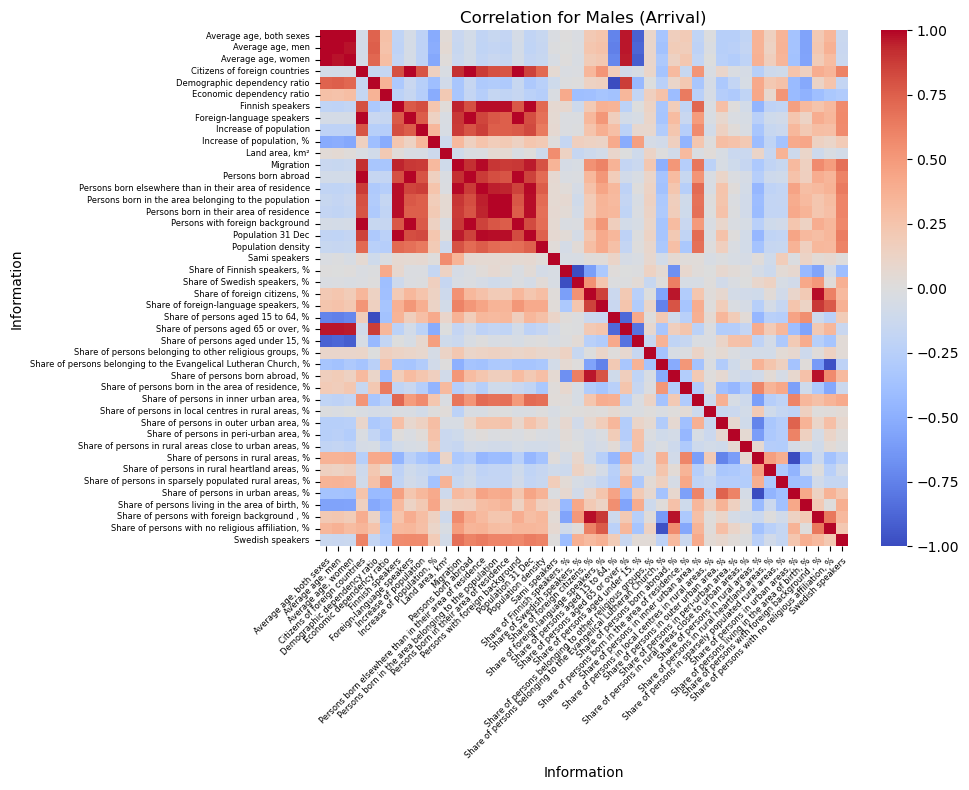

In [24]:
fig, ax = plt.subplots(1, 1, figsize=(10, 8))

sns.heatmap(male_corr, annot=False, cmap='coolwarm', vmin=-1, vmax=1,
            xticklabels=1, yticklabels=1, ax=ax)

ax.set_xticklabels(labels=male_corr.columns, rotation=45, 
                   ha="right", rotation_mode="anchor", 
                   fontsize=6)
plt.yticks(fontsize=6)
plt.title('Correlation for Males (Arrival)')
plt.tight_layout()
plt.savefig("images/male_migri_stats_corr.pdf")
plt.show()


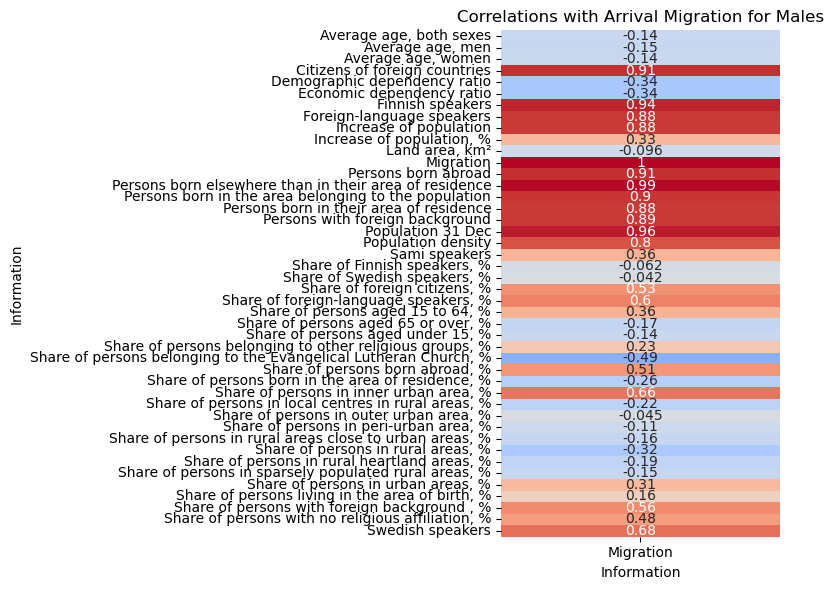

In [25]:
male_migration_correlations = male_corr.loc[['Migration']].transpose()

plt.figure(figsize=(8, 6))
sns.heatmap(
    male_migration_correlations,
    annot=True,
    cbar=False,
    cmap='coolwarm',
    vmin=-1,
    vmax=1,
    xticklabels=1,
    yticklabels=1
)
plt.title("Correlations with Arrival Migration for Males")
plt.tight_layout()
plt.savefig("images/male_migri_stats_migration_corr.pdf")
plt.show()


In [26]:
del male_corr

In [27]:
female_corr = \
    (female_stats_migri
     .pivot_table(
        index=["Arrival", "year"], 
        columns="Information",
        values="value")
     .reset_index()
     .drop(columns=["Arrival", "year"])
     .corr())

In [28]:
female_arr_info = (male_stats_migri
     .pivot_table(
        index=["Arrival", "year"], 
        columns="Information",
        values="value")
     .reset_index())

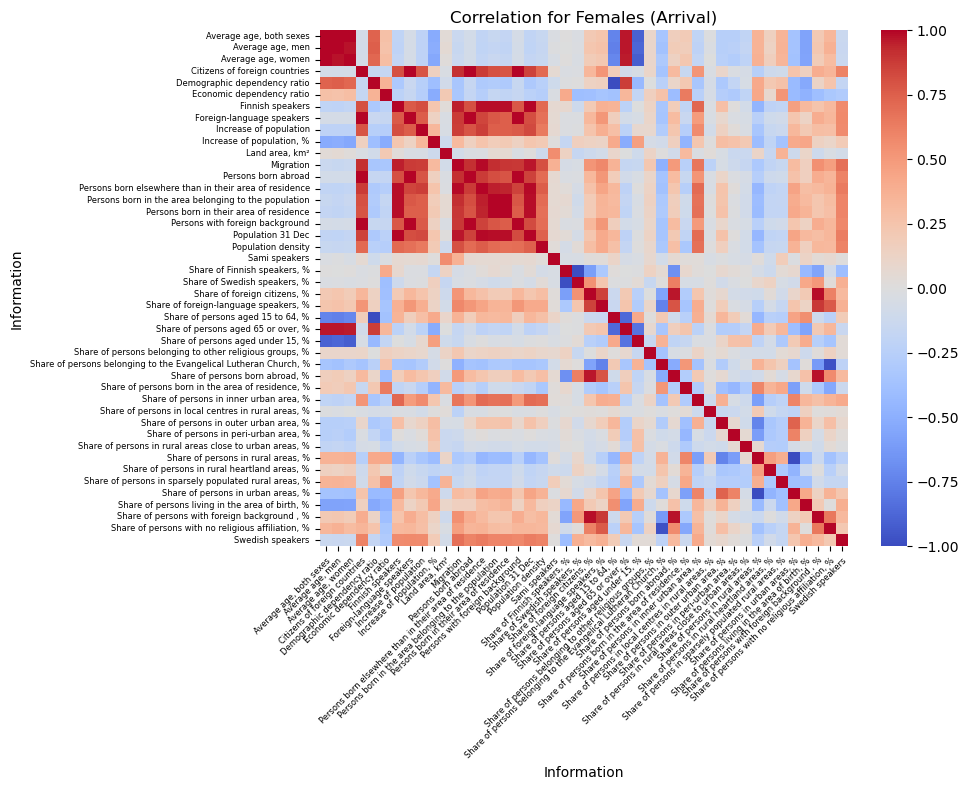

In [29]:
# These are the same as for Males except possibly in Migration

fig, ax = plt.subplots(1, 1, figsize=(10, 8))

sns.heatmap(female_corr, annot=False, cmap='coolwarm', vmin=-1, vmax=1,
            xticklabels=1, yticklabels=1, ax=ax)

ax.set_xticklabels(labels=female_corr.columns, rotation=45, 
                   ha="right", rotation_mode="anchor", 
                   fontsize=6)
plt.yticks(fontsize=6)
plt.title('Correlation for Females (Arrival)')
plt.tight_layout()
plt.savefig("images/female_migri_stats_corr.pdf")
plt.show()


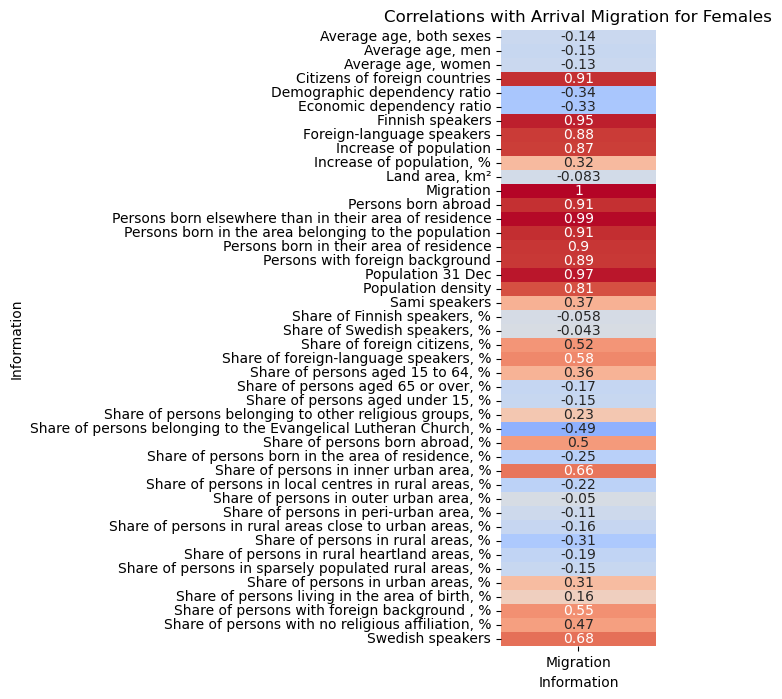

In [30]:
female_migration_correlations = female_corr.loc[['Migration']].transpose()

plt.figure(figsize=(2, 8))
sns.heatmap(
    female_migration_correlations,
    annot=True,
    cbar=False,
    cmap='coolwarm',
    vmin=-1,
    vmax=1,
    xticklabels=1,
    yticklabels=1
)
plt.title("Correlations with Arrival Migration for Females")
plt.savefig("images/female_migri_stats_migration_corr.pdf")
plt.show()


In [31]:
del female_corr

#### Are there difference in correlation between sexes?

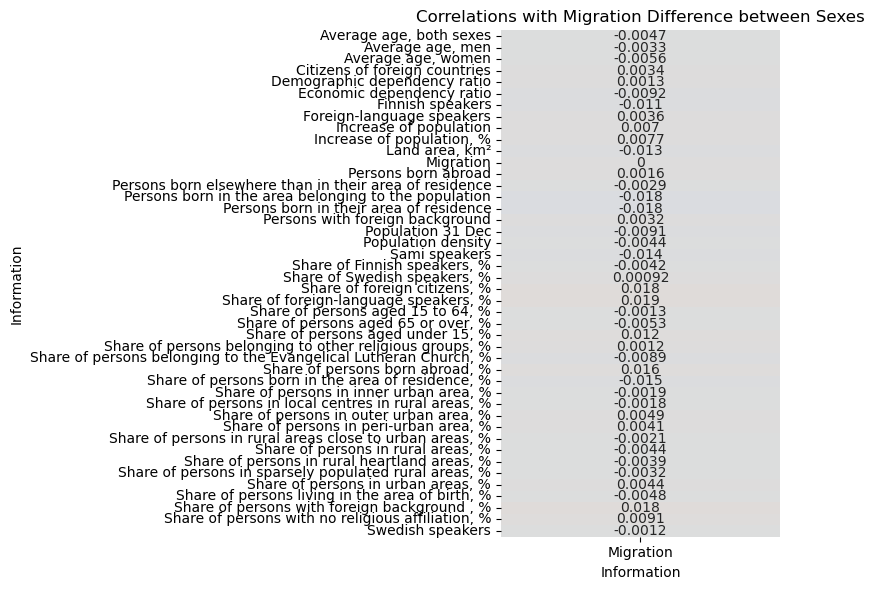

In [32]:
plt.figure(figsize=(8, 6))
sns.heatmap(
    male_migration_correlations - female_migration_correlations,
    annot=True,
    cbar=False,
    cmap='coolwarm',
    vmin=-1,
    vmax=1,
    xticklabels=1,
    yticklabels=1
)
plt.title("Correlations with Migration Difference between Sexes")
plt.tight_layout()
plt.savefig("images/male_female_migri_stats_migration_corr.pdf")
plt.show()


<span style="color:green; font-weight:bold">There are no differences between males and femals on the migration's linear correlation with  municipality key statistics.</span>

### We can repeate the same for ``Departure``

In [33]:
male_dep_agg = male_migri[["Departure", "year", "Migration"]].groupby(["Departure", "year"]).sum("Migration")
female_dep_agg = female_migri[["Departure", "year", "Migration"]].groupby(["Departure", "year"]).sum("Migration")

In [34]:
male_dep_agg = male_dep_agg.reset_index()
male_dep_agg["Information"] = "Migration"
male_dep_agg = male_dep_agg.rename(columns={"Migration": "value"})

In [35]:
male_stats_migri = pd.concat([male_dep_agg, 
                              mun_stats.rename(columns={"Area": "Departure"})])

In [36]:
female_dep_agg = female_dep_agg.reset_index()
female_dep_agg["Information"] = "Migration"
female_dep_agg = female_dep_agg.rename(columns={"Migration": "value"})

In [37]:
female_stats_migri = pd.concat([female_dep_agg, 
                                mun_stats.rename(columns={"Area": "Departure"})])

#### Correlations

In [38]:
male_corr = \
    (male_stats_migri
     .pivot_table(
        index=["Departure", "year"], 
        columns="Information",
        values="value")
     .reset_index()
     .drop(columns=["Departure", "year"])
     .corr())

In [39]:
male_dep_info = (male_stats_migri
     .pivot_table(
        index=["Departure", "year"], 
        columns="Information",
        values="value")
     .reset_index())

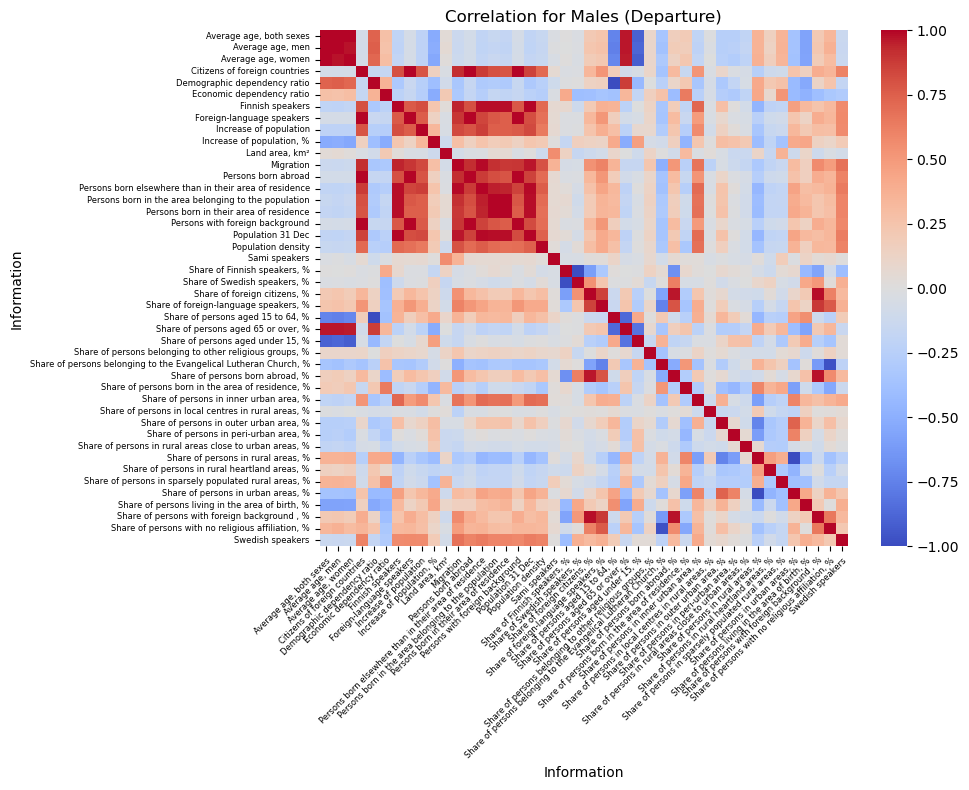

In [40]:
fig, ax = plt.subplots(1, 1, figsize=(10, 8))

sns.heatmap(male_corr, annot=False, cmap='coolwarm', vmin=-1, vmax=1,
            xticklabels=1, yticklabels=1, ax=ax)

ax.set_xticklabels(labels=male_corr.columns, rotation=45, 
                   ha="right", rotation_mode="anchor", 
                   fontsize=6)
plt.yticks(fontsize=6)
plt.title('Correlation for Males (Departure)')
plt.tight_layout()
plt.savefig("images/male_migri_stats_corr_departure.pdf")
plt.show()


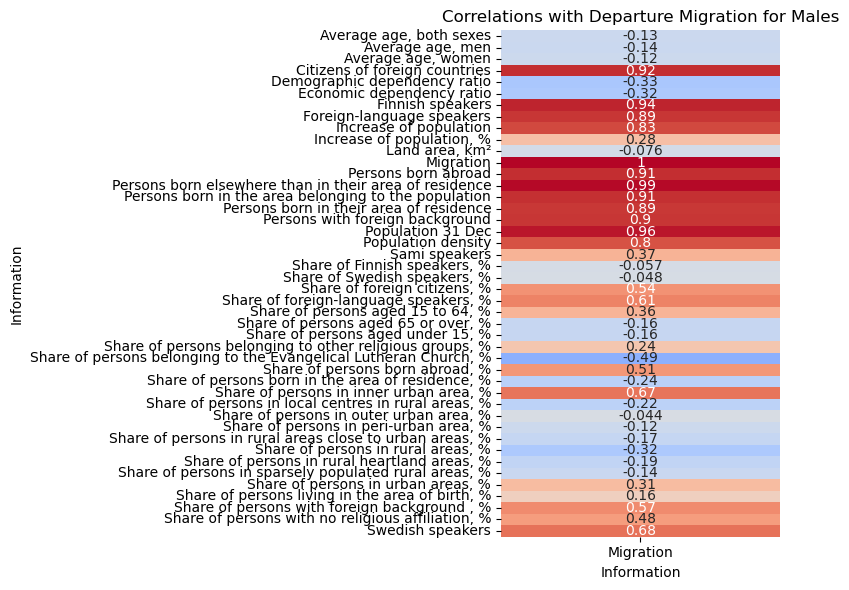

In [41]:
male_migration_correlations = male_corr.loc[['Migration']].transpose()

plt.figure(figsize=(8, 6))
sns.heatmap(
    male_migration_correlations,
    annot=True,
    cbar=False,
    cmap='coolwarm',
    vmin=-1,
    vmax=1,
    xticklabels=1,
    yticklabels=1
)
plt.title("Correlations with Departure Migration for Males")
plt.tight_layout()
plt.savefig("images/male_migri_stats_migration_corr_departure.pdf")
plt.show()


In [42]:
female_corr = \
    (female_stats_migri
     .pivot_table(
        index=["Departure", "year"], 
        columns="Information",
        values="value")
     .reset_index()
     .drop(columns=["Departure", "year"])
     .corr())

In [43]:
female_dep_info = (female_stats_migri
     .pivot_table(
        index=["Departure", "year"], 
        columns="Information",
        values="value")
     .reset_index())

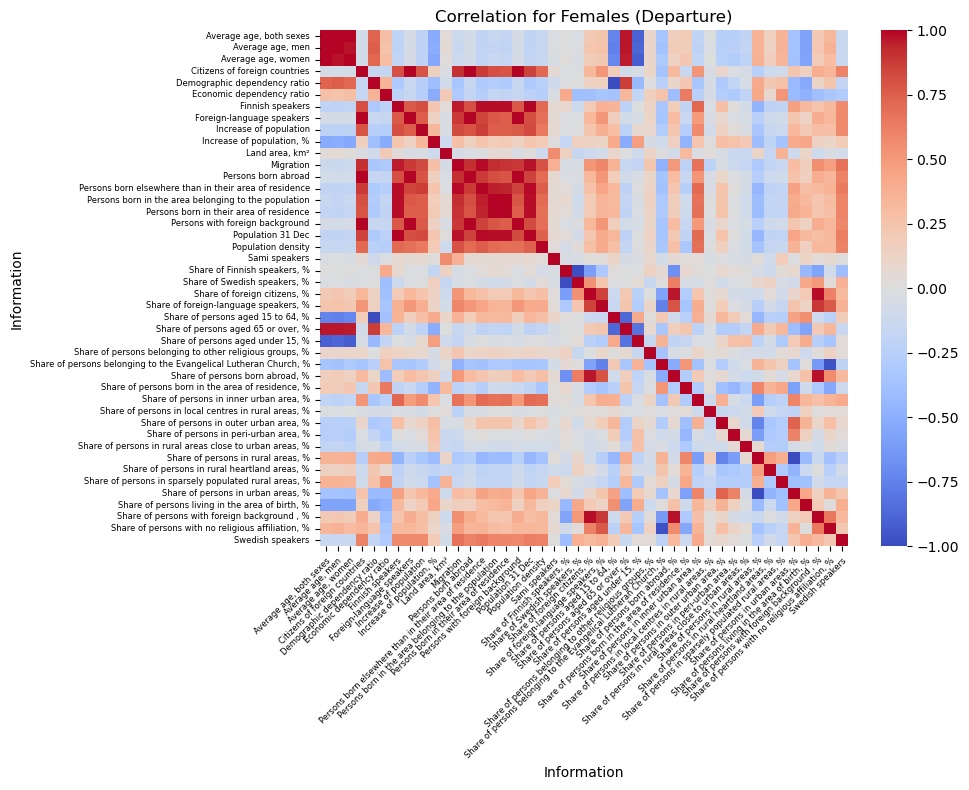

In [44]:
# These are the same as for Males except possibly in Migration

fig, ax = plt.subplots(1, 1, figsize=(10, 8))

sns.heatmap(female_corr, annot=False, cmap='coolwarm', vmin=-1, vmax=1,
            xticklabels=1, yticklabels=1, ax=ax)

ax.set_xticklabels(labels=female_corr.columns, rotation=45, 
                   ha="right", rotation_mode="anchor", 
                   fontsize=6)
plt.yticks(fontsize=6)
plt.title('Correlation for Females (Departure)')
plt.tight_layout()
plt.savefig("images/female_migri_stats_corr_departure.pdf")
plt.show()


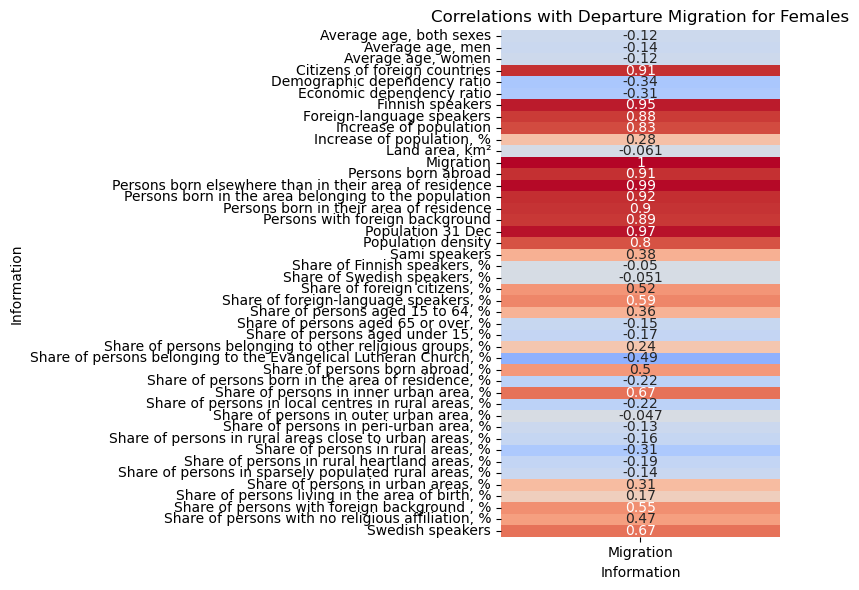

In [45]:
female_migration_correlations = female_corr.loc[['Migration']].transpose()

plt.figure(figsize=(8, 6))
sns.heatmap(
    female_migration_correlations,
    annot=True,
    cbar=False,
    cmap='coolwarm',
    vmin=-1,
    vmax=1,
    xticklabels=1,
    yticklabels=1
)
plt.title("Correlations with Departure Migration for Females")
plt.tight_layout()
plt.savefig("images/female_migri_stats_migration_corr_departure.pdf")
plt.show()


#### Are there difference in correlation between sexes?

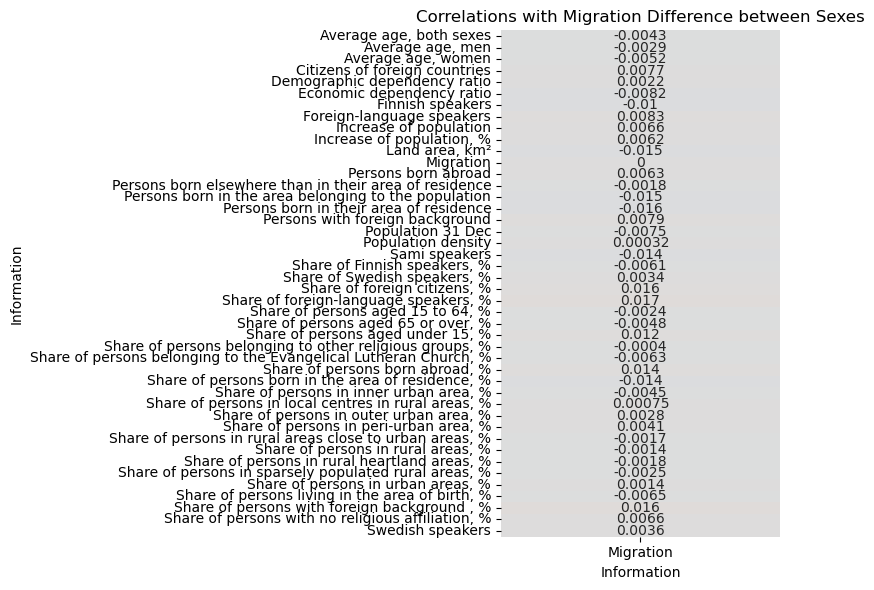

In [46]:
plt.figure(figsize=(8, 6))
sns.heatmap(
    male_migration_correlations - female_migration_correlations,
    annot=True,
    cbar=False,
    cmap='coolwarm',
    vmin=-1,
    vmax=1,
    xticklabels=1,
    yticklabels=1
)
plt.title("Correlations with Migration Difference between Sexes")
plt.tight_layout()
plt.savefig("images/male_female_migri_stats_migration_corr_departure.pdf")
plt.show()


<span style="color:green; font-weight:bold">Again, no differences between males and females.</span>

### Just looking at correlations not much can be said about why people are migrating within country. 
We could calculate departure-to-arrival  municipality differences and see these are different from the analysis above.

In [47]:
male_mun_diff = (male_migri
 .merge(male_arr_info.drop(columns=["Migration"]), on=["Arrival", "year"])
 .merge(male_dep_info.drop(columns=["Migration"]), on=["Departure", "year"])
)

In [48]:
# calculate the difference

x_cols = [col for col in male_mun_diff.columns if col.endswith('_x')]
y_cols = [col.replace('_x', '_y') for col in x_cols]  # same _x and _y cols

for x_col, y_col in zip(x_cols, y_cols):
    base_name = x_col.replace('_x', '')
    male_mun_diff[f'{base_name}_diff'] = male_mun_diff[x_col] - male_mun_diff[y_col]
    male_mun_diff.drop(columns=[x_col, y_col], inplace=True)

In [49]:
# Arrival - Departure stats
male_mun_diff["year"] = male_mun_diff["year"].astype("int")

In [50]:
_s = set(muns_of_interest)
male_mun_diff = \
    male_mun_diff.loc[((male_mun_diff["Arrival"].map(lambda x: x in _s)) & 
                       (male_mun_diff["Departure"].map(lambda x: x in _s))), :]

In [51]:
male_diff_corr = male_mun_diff.drop(columns=["Arrival", "Departure", "Sex"]).corr()

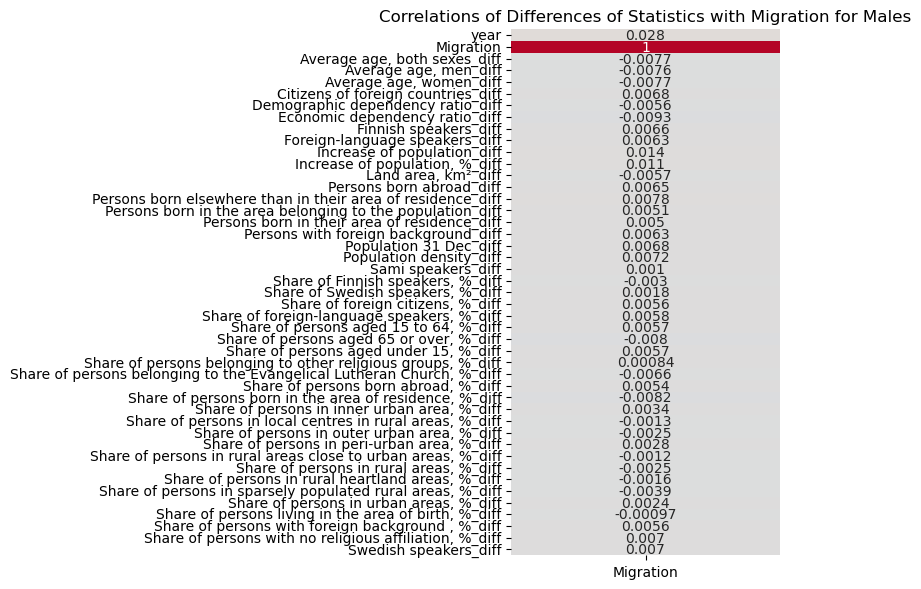

In [52]:
male_migration_diff_correlations = male_diff_corr.loc[['Migration']].transpose()

plt.figure(figsize=(8, 6))
sns.heatmap(
    male_migration_diff_correlations,
    annot=True,
    cbar=False,
    cmap='coolwarm',
    vmin=-1,
    vmax=1,
    xticklabels=1,
    yticklabels=1
)
plt.title("Correlations of Differences of Statistics with Migration for Males")
plt.tight_layout()
# plt.savefig("images/male_migri_stats_migration_corr_departure.pdf")
plt.show()

<span style="color:green; font-weight:bold">Differences by municipalities do not seem to correlate with the migration.</span>

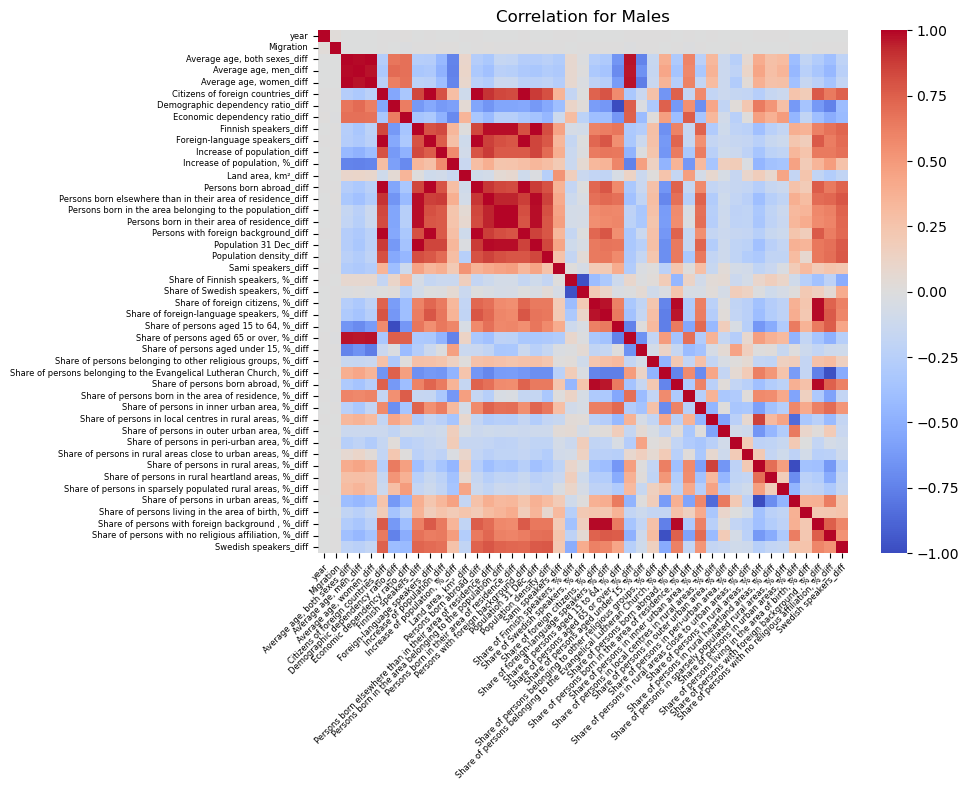

In [53]:
fig, ax = plt.subplots(1, 1, figsize=(10, 8))

sns.heatmap(male_diff_corr, annot=False, cmap='coolwarm', vmin=-1, vmax=1,
            xticklabels=1, yticklabels=1, ax=ax)

ax.set_xticklabels(labels=male_diff_corr.columns, rotation=45, 
                   ha="right", rotation_mode="anchor", 
                   fontsize=6)
plt.yticks(fontsize=6)
plt.title('Correlation for Males')
plt.tight_layout()
# plt.savefig("images/male_migri_stats_corr_departure.pdf")
plt.show()


Conclusion so far: there is no difference in correlations of migration for departure or arrival on whole data

### Let's see if migration's correlation changes by year.

In [54]:
male_dep_agg["year"] = male_dep_agg["year"].astype("int")

In [55]:
male_dep_info["year"] = male_dep_info["year"].astype("int")

In [56]:
male_migri_corrs = []
years = list(sorted(male_dep_agg["year"].unique()))

for year in years:
    male_dep_mun = male_dep_agg.loc[male_dep_agg["year"] == year, :].merge(
        male_dep_info.drop(columns=["Migration"]), on=["Departure", "year"])
    
    male_dep_mun_corr = male_dep_mun.drop(
        columns=["Departure", "year", "Information"]).rename(columns={"value": "Migration"}).corr()
    
    male_dep_mun_migration_corr = male_dep_mun_corr.loc[['Migration']].transpose()
    male_migri_corrs.append(male_dep_mun_migration_corr)

In [57]:
male_migri_year = pd.concat(male_migri_corrs, axis=1)
male_migri_year.columns = years

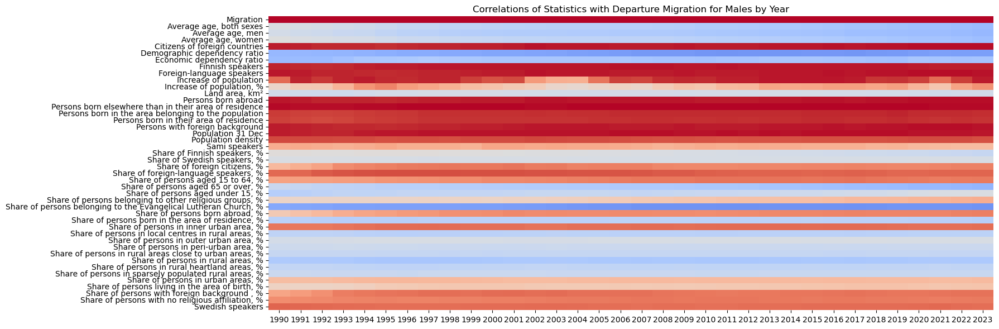

In [58]:
plt.figure(figsize=(18, 6))
sns.heatmap(
    male_migri_year,
    annot=False,
    cbar=False,
    cmap='coolwarm',
    vmin=-1,
    vmax=1,
    xticklabels=1,
    yticklabels=1
)
plt.title("Correlations of Statistics with Departure Migration for Males by Year")
plt.tight_layout()
plt.savefig("images/male_migri_stats_migration_corr_departure_yearly.pdf")
plt.show()

In [59]:
male_migri_corrs = []
years = list(sorted(male_arr_agg["year"].unique()))

for year in years:
    male_arr_mun = male_arr_agg.loc[male_arr_agg["year"] == year, :].merge(
        male_arr_info.drop(columns=["Migration"]), on=["Arrival", "year"])
    
    male_arr_mun_corr = male_arr_mun.drop(
        columns=["Arrival", "year", "Information"]).rename(columns={"value": "Migration"}).corr()
    
    male_arr_mun_migration_corr = male_arr_mun_corr.loc[['Migration']].transpose()
    male_migri_corrs.append(male_arr_mun_migration_corr)

In [60]:
male_migri_year = pd.concat(male_migri_corrs, axis=1)
male_migri_year.columns = years

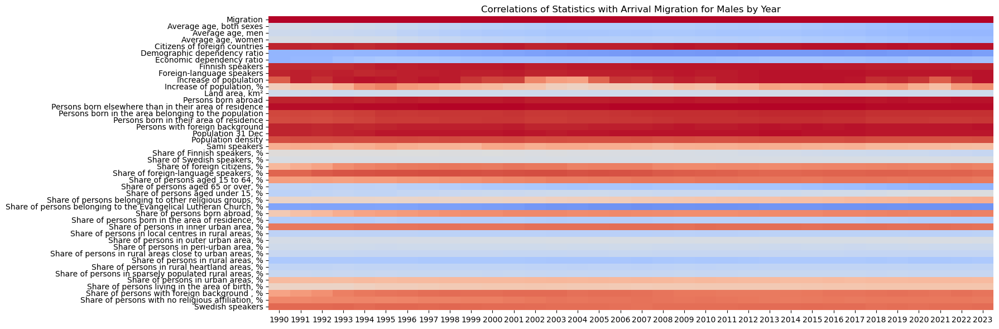

In [61]:
plt.figure(figsize=(18, 6))
sns.heatmap(
    male_migri_year,
    annot=False,
    cbar=False,
    cmap='coolwarm',
    vmin=-1,
    vmax=1,
    xticklabels=1,
    yticklabels=1
)
plt.title("Correlations of Statistics with Arrival Migration for Males by Year")
plt.tight_layout()
# plt.savefig("images/male_migri_stats_migration_corr_arrival_by_year.pdf")
plt.show()

It seems there is some variablility in the increase of population around years 2003 and 2021.

In [62]:
male_mun_diff

,Arrival,Departure,year,Migration,Sex,"Average age, both sexes_diff","Average age, men_diff","Average age, women_diff",Citizens of foreign countries_diff,Demographic dependency ratio_diff,...,"Share of persons in peri-urban area, %_diff","Share of persons in rural areas close to urban areas, %_diff","Share of persons in rural areas, %_diff","Share of persons in rural heartland areas, %_diff","Share of persons in sparsely populated rural areas, %_diff","Share of persons in urban areas, %_diff","Share of persons living in the area of birth, %_diff","Share of persons with foreign background , %_diff","Share of persons with no religious affiliation, %_diff",Swedish speakers_diff
0,Akaa,Espoo,1990,3,male,4.7,3.6,5.8,-1986.0,11.4,...,-0.2,45.3,96.2,1.5,0.0,-96.6,-11.3,-1.0,-4.3,-18609.0
1,Eura,Espoo,1990,2,male,6.0,4.8,7.1,-2032.0,14.3,...,1.9,0.0,93.7,46.1,1.2,-94.5,-9.2,-1.3,-9.4,-18574.0
2,Forssa,Espoo,1990,7,male,4.3,3.2,5.4,-1999.0,6.5,...,2.4,6.2,6.9,0.6,0.0,-7.1,-8.4,-1.2,-5.6,-18581.0
3,Hamina,Espoo,1990,5,male,5.3,4.7,5.9,-1978.0,7.0,...,19.7,9.6,10.1,0.2,0.2,-10.3,-1.3,-1.0,-9.1,-18551.0
4,Heinola,Espoo,1990,9,male,4.1,3.6,4.7,-2000.0,3.8,...,10.4,3.6,4.7,0.0,1.1,-4.6,-3.5,-1.2,-6.2,-18574.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154372,Tampere,Alavus,2023,26,male,-5.7,-5.9,-5.6,17149.0,-38.1,...,0.5,1.3,-97.7,-94.8,-4.3,97.4,7.6,7.8,24.7,1371.0
154373,Turku,Alavus,2023,3,male,-4.8,-5.1,-4.6,18838.0,-35.6,...,5.4,0.4,-98.7,-94.8,-4.3,98.2,5.4,12.9,24.8,10975.0
154374,Vaasa,Alavus,2023,7,male,-5.1,-5.3,-4.8,5662.0,-30.9,...,5.2,5.9,-93.2,-94.8,-4.3,93.3,8.5,9.7,17.0,16011.0
154375,Vantaa,Alavus,2023,4,male,-6.9,-6.8,-6.9,42142.0,-36.9,...,1.5,0.0,-99.1,-94.8,-4.3,97.9,1.7,24.7,33.0,5380.0


Economic dependency ratio_diff
Share of persons born in the area of residence, %_diff
Share of persons in inner urban area, %_diff
Share of persons in rural areas, %_diff
Share of persons in rural heartland areas, %_diff
Share of persons in urban areas, %_diff


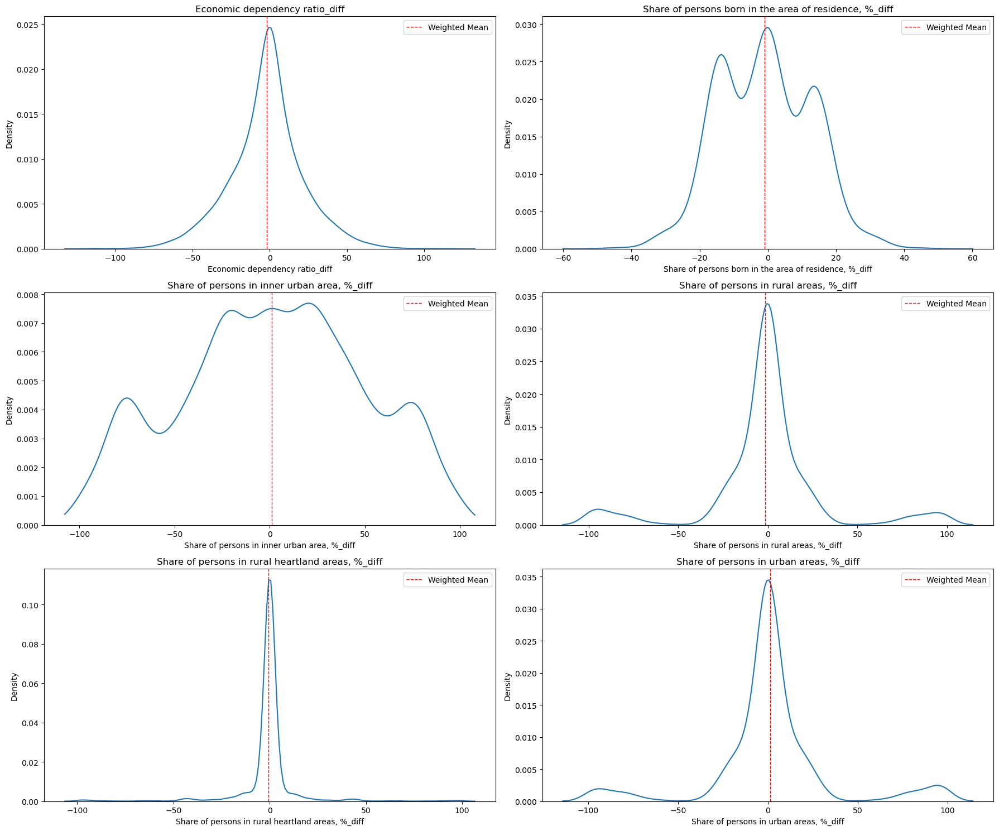

In [63]:
features = male_mun_diff.columns.tolist()[5:]
columns_to_drop = {s for s in features if not any(sub in s for sub in ['%', 'Average', ' ratio'])}
features = [f for f in features if f not in columns_to_drop]
_from_zero = []

for feat in features: 
    weighted_mean = np.average(male_mun_diff[feat], weights=male_mun_diff["Migration"])
    _from_zero.append(np.abs(weighted_mean))

top_n = 6
_largest_abs = np.array(features)[np.argsort(_from_zero)[::-1][:top_n]].tolist()

n_cols = 2
n_rows = -(-top_n // n_cols)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(18, 5*n_rows))
axs = axs.flatten()

idx = 0

for feat in features:
    if feat not in _largest_abs:
        continue
    
    print(f'{feat}')

    weighted_mean = np.average(male_mun_diff[feat], weights=male_mun_diff["Migration"])
    
    sns.kdeplot(
        data=male_mun_diff,
        x=feat,
        weights="Migration",
        fill=False,
        ax=axs[idx]
    )
    
    axs[idx].axvline(weighted_mean, 
                color='red', 
                linestyle='--', 
                linewidth=1, 
                label='Weighted Mean')
    
    axs[idx].set_title(feat)
    axs[idx].legend()
    idx += 1

plt.tight_layout()
for i in range(len(features), len(axs)):
    axs[i].set_visible(False)  # Hide empty subplots
# plt.savefig("images/diff_histograms_males_top6.pdf")
plt.show()

#### PCA

In [64]:
arrivals = (
    male_mun_diff.groupby(['year', 'Arrival'])['Migration']
    .sum()
    .reset_index()
    .rename(columns={'Arrival': 'Municipality', 'Migration': 'Arrivals'})
)

departures = (
    male_mun_diff.groupby(['year', 'Departure'])['Migration']
    .sum()
    .reset_index()
    .rename(columns={'Departure': 'Municipality', 'Migration': 'Departures'})
)

net_migration = pd.merge(arrivals, departures, on=['year', 'Municipality'], how='outer')
net_migration = net_migration.fillna(0)

net_migration['Net_Migration'] = net_migration['Arrivals'] - net_migration['Departures']

In [65]:
net_migration.dtypes

year              int64
Municipality     object
Arrivals          int64
Departures        int64
Net_Migration     int64
dtype: object

In [66]:
male_arr_info["year"] = male_arr_info["year"].astype("int")

In [67]:
net_migration_w_stats = \
    net_migration.merge(male_arr_info, left_on=["year", "Municipality"], right_on=["year", "Arrival"])

# net_migration_w_stats.drop(columns=["Municipality", "Arrivals", "Departures", "Arrival"], inplace=True)
net_migration_w_stats.drop(columns=["Arrivals", "Departures", "Arrival"], inplace=True)

In [68]:
_agg_dict = {col: 'mean' for col in net_migration_w_stats.columns if col not in ['Net_Migration', 'Municipality', 'year']}
_agg_dict['Net_Migration'] = 'sum'

net_migration_w_stats = net_migration_w_stats.groupby(['Municipality'], as_index=False).agg(_agg_dict)

In [69]:
columns_to_drop = [s for s in net_migration_w_stats.columns.tolist() if not any(sub in s for sub in ['%', 'Average', ' ratio', 'Net_'])]
net_migration_w_stats.drop(columns=columns_to_drop, inplace=True)

In [70]:
"share of".replace("share", "s")

's of'

In [71]:
## select features
features = [col for col in net_migration_w_stats.columns if net_migration_w_stats[col].dtype != 'object']
X = net_migration_w_stats[features].dropna()  # Drop rows with missing values

## scale
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

## run pca
pca = PCA()
X_pca = pca.fit_transform(X_scaled)
loadings = pca.components_.T  # shape: (n_features, n_components)

## biplot

explained_var = pca.explained_variance_ratio_
cumulative_var = np.cumsum(explained_var)

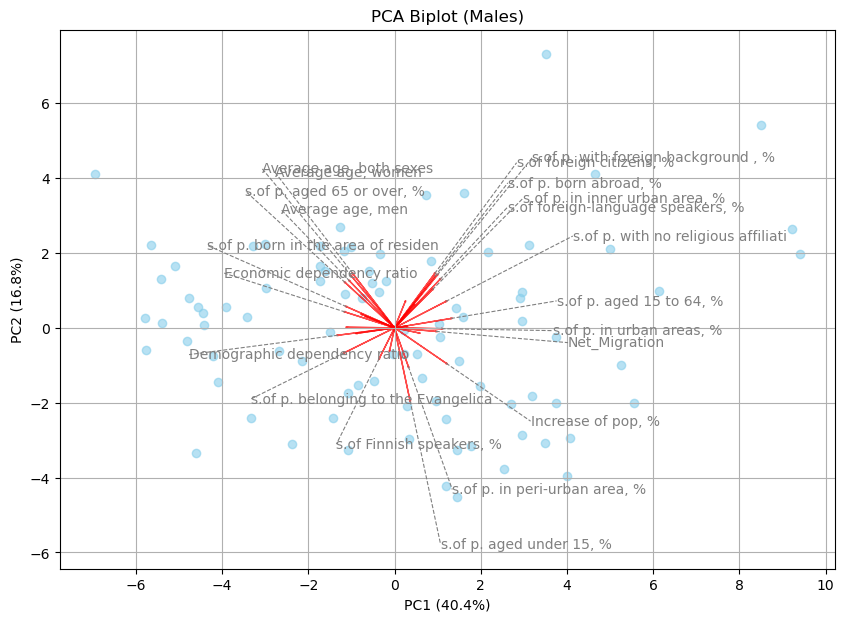

In [72]:
arrow_scale = 5  # Adjust as needed
text_offset = 2  # How far from arrow tip to place the label

plt.figure(figsize=(10, 7))
plt.scatter(X_pca[:, 0], X_pca[:, 1], alpha=0.6, color='skyblue', label='Municipalities')

n_top = 20
top_features_idx = np.argsort(np.abs(loadings[:, 0]) + np.abs(loadings[:, 1]))[::-1][:n_top]
selected = 0
np.random.seed(10)

for i, feature in enumerate(features):
    feature = (feature
               .replace("Share of", "s.of")
               .replace("persons", "p.")
               .replace("population", "pop"))[:35]
    
    # Arrow end coordinates
    x = loadings[i, 0] * arrow_scale
    y = loadings[i, 1] * arrow_scale
    plt.arrow(0, 0, x, y, color='r', alpha=0.7, head_width=0.03)

    if not (i in top_features_idx or feature == "Net_Migration"):
        continue 

    selected += 1
    
    # Calculate angle in degrees
    angle = np.degrees(np.arctan2(y, x))
    
    # Calculate label position further out in the same direction
    norm = np.sqrt(x**2 + y**2)
    _off = max(0.25, np.random.random(1)[0])
    label_x = x + (x / norm) * (1 + _off) * text_offset
    label_y = y + (y / norm) * (1 + _off) * text_offset

    # Draw a thin gray line from arrow tip to label
    plt.plot([x, label_x], [y, label_y], color='gray', linewidth=0.8, linestyle='--')
    
    # Place the label horizontally
    plt.text(label_x, label_y, feature, color='gray', 
             fontsize=10, ha='left', va='center', 
             rotation=0, rotation_mode='anchor')

plt.xlabel('PC1 (%.1f%%)' % (explained_var[0]*100))
plt.ylabel('PC2 (%.1f%%)' % (explained_var[1]*100))
plt.title('PCA Biplot (Males)')
plt.grid(True)
# plt.savefig("images/biplot_male.pdf")
plt.show()


## How far are people moving?

The hypothesis is that females move further than males.

In [73]:
# We use geopy to get the distances between municipalities.

# Initialize geolocator
# geolocator = Nominatim(user_agent="municipality_distance")

def get_coordinates(municipality):
    location = geolocator.geocode(f"{municipality}, Finland")
    if location:
        return (location.latitude, location.longitude)
    else:
        return None

# mun_locations = {m: get_coordinates(m) for m in muns_of_interest}
# pd.DataFrame(mun_locations).transpose().rename(columns={0: "lat", 1: "lon"}).to_csv("data/municipality_coordinates.csv")

In [74]:
mun_coords = pd.read_csv("data/municipality_coordinates.csv", index_col=0)

In [75]:
def compute_distance_matrix(df):
    # not efficient
    
    municipalities = df["Municipality"]
    distances = pd.DataFrame(index=municipalities, columns=municipalities)

    for i, row1 in df.iterrows():
        for j, row2 in df.iterrows():
            loc1 = (row1["lat"], row1["lon"])
            loc2 = (row2["lat"], row2["lon"])
            distances.loc[row1["Municipality"], row2["Municipality"]] = geodesic(loc1, loc2).kilometers

    return distances

distance_matrix = compute_distance_matrix(mun_coords.reset_index().rename(columns={"index": "Municipality"}))

In [76]:
# rotate through wide form to avoid recomputation of distance for each year
_w = (male_migri
     .pivot(values="Migration", columns="year", index=["Arrival", "Departure"])
     .reset_index())

_w["Distance"] = [distance_matrix[row["Arrival"]][row["Departure"]] for (i, row) in _w.iterrows()]

male_migri = _w.melt(id_vars=["Arrival", "Departure", "Distance"], var_name="year", value_name="Migration").dropna()

In [77]:
# rotate through wide form to avoid recomputation of distance for each year
_w = (female_migri
     .pivot(values="Migration", columns="year", index=["Arrival", "Departure"])
     .reset_index())

_w["Distance"] = [distance_matrix[row["Arrival"]][row["Departure"]] for (i, row) in _w.iterrows()]

female_migri = _w.melt(id_vars=["Arrival", "Departure", "Distance"], var_name="year", value_name="Migration").dropna()

del _w

In [78]:
male_migri["Sex"] = "Male"
female_migri["Sex"] = "Female"

In [79]:
# (male_migri["Distance"] * male_migri["Migration"]).describe()

In [80]:
# (female_migri["Distance"] * female_migri["Migration"]).describe()

In [81]:
# (female_migri.groupby(["year"])["Migration"].sum() - male_migri.groupby(["year"])["Migration"].sum())

In [82]:
df = pd.concat([male_migri, female_migri])

df["person_km"] = df["Migration"] * df["Distance"]

In [83]:
# df["person_km"].describe()

In [84]:
# df.loc[df["person_km"] > 100000, :]

In [85]:
df["person_km_log10"] = np.log10(df["person_km"])

In [86]:
df["Migration_log10"] = np.log10(df["Migration"])

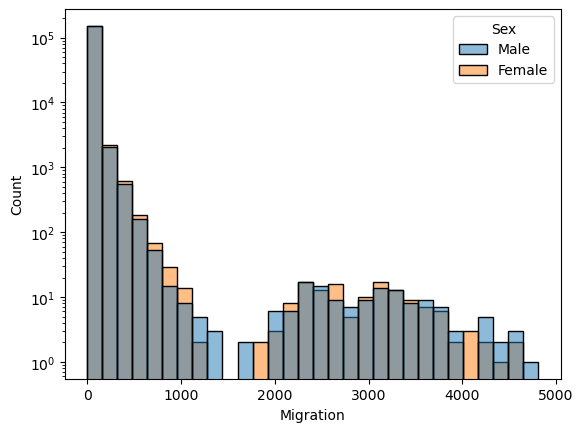

In [87]:
sns.histplot(data=df, x="Migration", hue="Sex", bins=30, log_scale=(False, True));

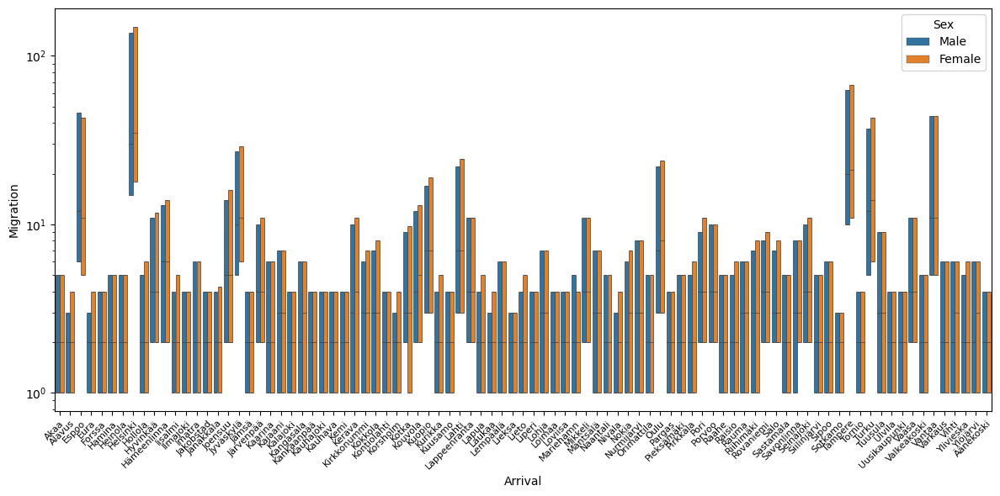

In [88]:
plt.figure(figsize=(12, 6)) 
ax = sns.boxplot(data=df, y="Migration", x="Arrival", hue="Sex", 
                 showfliers=False, whis=0, linewidth=0.5)

ax.set_yscale("log")

ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    ha="right",
    rotation_mode="anchor",
    fontsize=8
)
plt.tight_layout()
plt.savefig("images/arrival_mig_by_mun.pdf")
plt.show()

Seems like females tend to migrate into more than males for the largest cities, except for Espoo. 

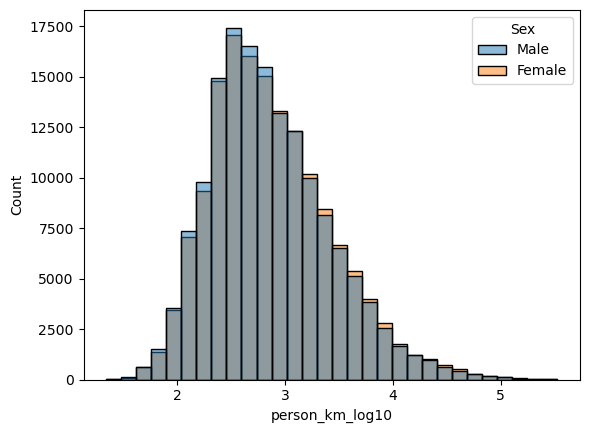

In [89]:
sns.histplot(data=df, x="person_km_log10", hue="Sex", bins=30);

The migration appears to be further in distances as well.

We can check if this is stationary by year.

In [90]:
grouped = df.groupby(["year", "Sex"])["person_km_log10"].agg(
    mean="mean",
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75),
).reset_index()

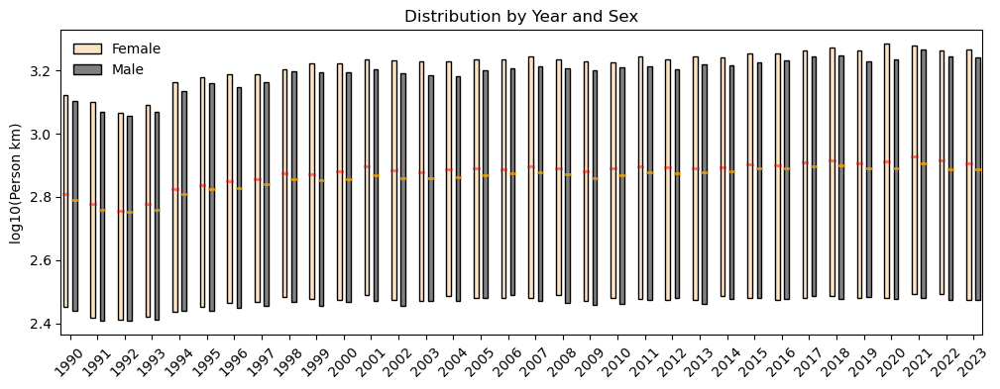

In [91]:
def create_boxplot(year, sex, mean, q25, q75, figsize=(12, 4)):
    
    # Calculate whiskers (1.5*IQR)
    iqr = q75 - q25
    whislo = q25 - 1.5 * iqr  # Lower whisker
    whishi = q75 + 1.5 * iqr  # Upper whisker
    
    # Create bxpstats structure for matplotlib
    bxpstats = []
    for y, s, m, q1, q3, wlo, whe in zip(year, sex, mean, q25, q75, whislo, whishi):
        bxpstats.append({
            'whishi': None,#whe,
            'whislo': None, #wlo,
            'fliers': [],
            'q1': q1,
            'med': m,
            'q3': q3
        })
    
    # Create figure and axis
    fig, ax = plt.subplots(figsize=figsize)
    
    # Create boxplot
    # positions = np.arange(len(year)) * 2  # Space for male/female
    positions = [i for pair in range(len(year) // 2) for i in [pair*3+1, pair*3+2]]
    labels = [f"{y} {sex}" for y, sex in zip(year, sex)]

    colors = ['gray'] * len(labels)
    colors = ['bisque' if i%2==0 else 'gray' for i in range(len(labels))]
    
    # Plot boxes for each group
    # for pos, label, stat in zip(positions, labels, bxpstats):
    bplot = ax.bxp(bxpstats, positions=positions, patch_artist=True,
                   boxprops={'linewidth': 1}, medianprops={'linewidth': 2})

    # fill with colors
    for patch, color in zip(bplot['boxes'], colors):
        patch.set_facecolor(color)

    # set media color
    for idx, median in enumerate(bplot['medians']):
        if idx%2:
            median.set_color('orange')
            median.set_alpha(0.75)
        else:
            median.set_color('red')
            median.set_alpha(0.5)
        
    # Customize plot
    # ax.set_xticks(positions)
    ax.set_xticks([(a+b)/2 for (a, b) in zip(positions[:-1:2], positions[1::2])], minor=False)
    ax.set_xticklabels(year[::2], rotation=45)
    ax.set_ylabel('log10(Person km)')
    ax.set_title('Distribution by Year and Sex')

    ax.yaxis.grid(False, which='major')
    ax.xaxis.grid(False, which='major')

    ax.legend([bplot["boxes"][0], bplot["boxes"][1]], 
              ['Female', 'Male'], loc='upper left',
              frameon=False)
    
    return fig, ax

fig, ax = create_boxplot(grouped["year"], grouped["Sex"], 
                         grouped["mean"], grouped["q25"], grouped["q75"])
plt.savefig("images/female_male_distance_person_km.pdf")
plt.show()

In [92]:
df["year"] = df["year"].astype("int")
df["bin"] = pd.cut(df["year"], bins=6, precision=0)

In [93]:
grouped = df.groupby(["bin", "Sex"])["person_km_log10"].agg(
    mean="mean",
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75),
).reset_index()

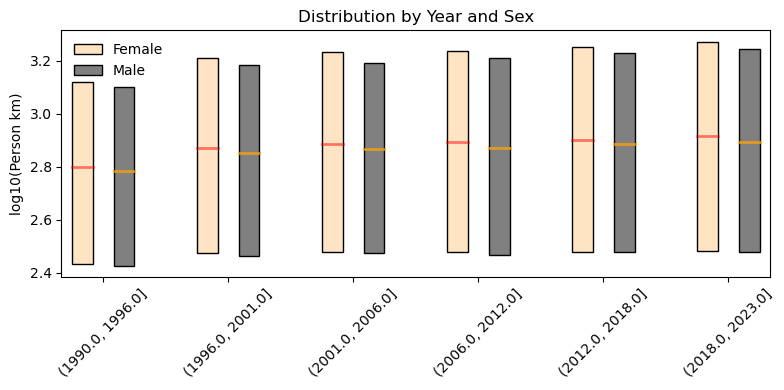

In [94]:
fig, ax = create_boxplot(grouped["bin"], grouped["Sex"], 
                         grouped["mean"], grouped["q25"], grouped["q75"],
                         figsize=(8, 4))
plt.tight_layout()
plt.savefig("images/female_male_distance_person_km_binned.pdf")
plt.show()

We see that Females consistently travel further than Males

## Next, let's add Map and Chord visualizations and see if they reveal anything

In [95]:
# finland = gpd.read_file('https://geo.stat.fi/geoserver/wfs?service=WFS&version=1.0.0&request=GetFeature&typeName=tilastointialueet:kunta4500k&outputFormat=json')

In [96]:

#with open("data/finland.pkl", "wb") as f:
#    pickle.dump(finland, f)

with open("data/finland.pkl", "rb") as f:
    finland = pickle.load(f)

In [97]:
df = copy.deepcopy(female_migri)

df["year"] = df["year"].astype("int")
df["bin"] = pd.cut(df["year"], bins=6, precision=0)

df = df.groupby(["bin", "Arrival", "Departure"])["Migration"].agg(
    sum="sum",
).reset_index()

df = df.loc[df["sum"] != 0, :]

In [98]:
flow_data = df

# Merge with municipality coordinates
dep_coords = finland[['nimi', 'geometry']].rename(columns={'nimi': 'Departure'})
arr_coords = finland[['nimi', 'geometry']].rename(columns={'nimi': 'Arrival'})

flow_data = flow_data.merge(
    dep_coords, 
    on='Departure'
).merge(
    arr_coords, 
    on='Arrival',
    suffixes=('_dep', '_arr')
)

In [99]:
flow_data = flow_data.rename(columns={"sum": "Migration"})

In [100]:
_bin_sums = flow_data.groupby(["bin"])["Migration"].sum()

In [101]:
flow_data["Migration_norm"] = [m / _bin_sums[bin] for (m, bin) in zip(flow_data["Migration"], flow_data["bin"])]

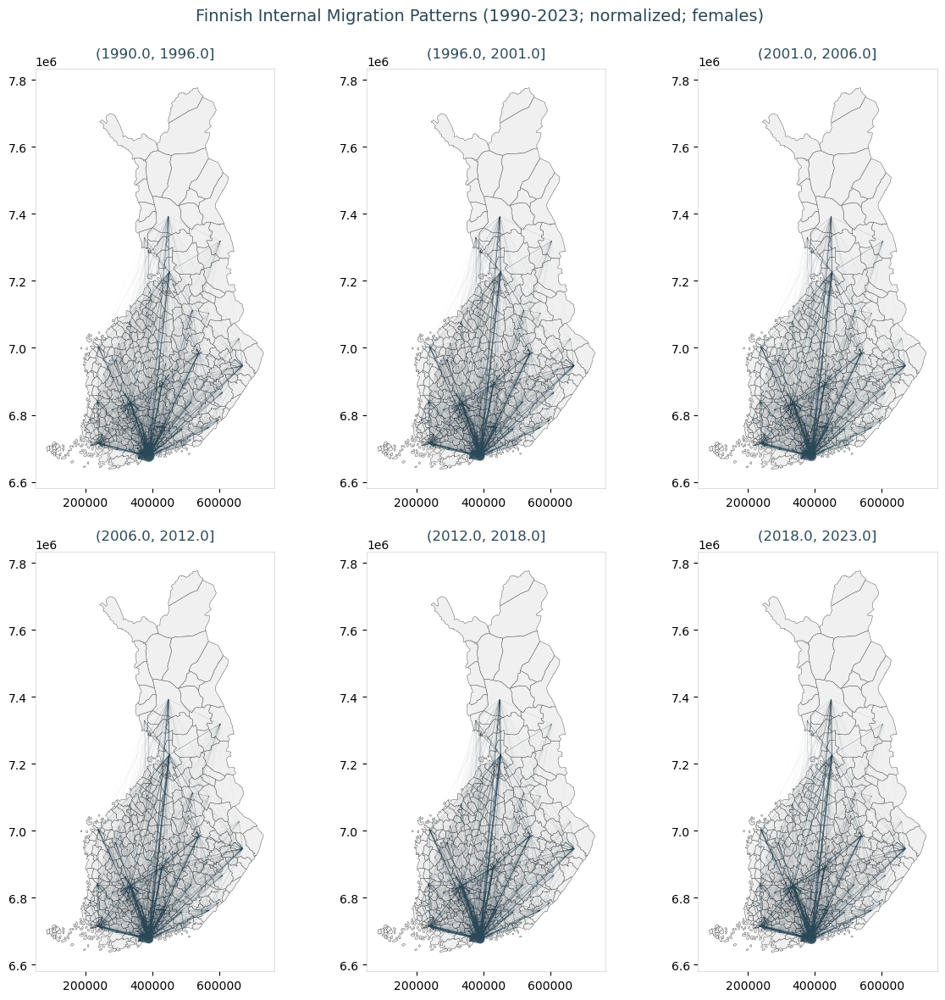

In [102]:
def create_3d_base(ax):
    finland.plot(
        ax=ax,
        facecolor='#f0f0f0',
        edgecolor='#444444',
        linewidth=0.3,
        aspect='equal'
    )

flow_data['dep_centroid'] = flow_data['geometry_dep'].map(lambda x: x.centroid)
flow_data['arr_centroid'] = flow_data['geometry_arr'].map(lambda x: x.centroid)

# Create figure with 6 panels
fig, axes = plt.subplots(2, 3, figsize=(12, 12))
axes = axes.flatten()
bins = sorted(flow_data['bin'].unique())

_min = flow_data['Migration_norm'].min()
_max = flow_data['Migration_norm'].max()

norm = mcolors.Normalize(vmin=_min, vmax=_max)

cmap = plt.get_cmap('YlGnBu')
base_color = '#2a4858'  # Deep blue-green

# flow_data['dep_centroid'] = flow_data['geometry_dep'].map(lambda x: x.centroid)
# flow_data['arr_centroid'] = flow_data['geometry_arr'].map(lambda x: x.centroid)

for i, bin in enumerate(bins):
    ax = axes[i]
    create_3d_base(ax)
    

    period_flows = flow_data[flow_data['bin'] == bin]
    
    # Then add arrows (foreground)
    arrows = []
    widths = []
    colors = []
    for _, row in period_flows.iterrows():
        start = [row['dep_centroid'].x, row['dep_centroid'].y]
        end = [row['arr_centroid'].x, row['arr_centroid'].y]
        arrows.append([start, end])
        # widths.append(np.log10(row['Migration'] + 1) * 0.1)  # Logarithmic scaling
        widths.append(row['Migration_norm'] / _max * 10.0)  # Linear scaling
        colors.append(cmap(norm(row['Migration_norm'])))
            
    lc = LineCollection(
        arrows,
        linewidths=widths,
        colors=base_color,
        alpha=0.5,
        capstyle='round'
    )
    ax.add_collection(lc)
    
    # Add colorbar to first panel only
    #if i == 0:
    #    cax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    #    fig.colorbar(hb, cax=cax, label='Migration Density (log)')

    # Add period title
    ax.set_title(bin, fontsize=12, pad=10, color=base_color)
    
    # Add subtle shadow for 3D effect
    for spine in ax.spines.values():
        spine.set_edgecolor('#d0d0d0')
        spine.set_linewidth(0.5)

# Final layout adjustments
plt.suptitle("Finnish Internal Migration Patterns (1990-2023; normalized; females)", 
            y=0.98, fontsize=14, color=base_color)
plt.tight_layout()
plt.subplots_adjust(top=0.92, wspace=0.05, hspace=0.15)
plt.savefig('images/finland_female_migration_binned_normalized.png', dpi=300, bbox_inches='tight')
# plt.savefig('images/finland_migration_binned.pdf', dpi=300, bbox_inches='tight')
plt.show()

From this figure we can see the general migration between the largest municipalities, but there does not seem to be readily interpretable differnces by years.

_year_sums = male_stats_migri.loc[male_stats_migri["Information"] == "Migration", :].groupby("year")["value"].sum()

male_stats_migri_norm = copy.deepcopy(male_stats_migri)

male_stats_migri_norm.loc[male_stats_migri_norm["Information"] == "Migration", "value"] = \
    [m / _year_sums[year] for (m, year) in zip(
        male_stats_migri_norm.loc[male_stats_migri_norm["Information"] == "Migration", "value"], 
        male_stats_migri_norm.loc[male_stats_migri_norm["Information"] == "Migration", "year"])]

male_stats_migri_norm

male_corr = \
    (male_stats_migri_norm
     .pivot_table(
        index=["Departure", "year"], 
        columns="Information",
        values="value")
     .reset_index()
     .drop(columns=["Departure", "year"])
     .corr())

fig, ax = plt.subplots(1, 1, figsize=(10, 8))

sns.heatmap(male_corr, annot=False, cmap='coolwarm', vmin=-1, vmax=1,
            xticklabels=1, yticklabels=1, ax=ax)

ax.set_xticklabels(labels=male_corr.columns, rotation=45, 
                   ha="right", rotation_mode="anchor", 
                   fontsize=6)
plt.yticks(fontsize=6)
plt.title('Correlation for Males Departure')
plt.tight_layout()
plt.savefig("images/male_migri_stats_corr_norm_dep.pdf")
plt.show()


male_migration_correlations = male_corr.loc[['Migration']].transpose()

plt.figure(figsize=(8, 6))
sns.heatmap(
    male_migration_correlations,
    annot=True,
    cbar=False,
    cmap='coolwarm',
    vmin=-1,
    vmax=1,
    xticklabels=1,
    yticklabels=1
)
plt.title("Correlations with Migration for Males")
plt.tight_layout()
plt.savefig("images/male_migri_stats_migration_corr_norm_dep.pdf")
plt.show()


### Chord diagrams for migrations between municipalities

In [103]:
total_migri = female_migri.merge(male_migri, on=["Arrival", "Departure", "year"])
total_migri["Migration"] = total_migri["Migration_x"] + total_migri["Migration_y"]
total_migri = total_migri[["Arrival", "Departure", "year", "Migration"]]
total_migri["year"] = total_migri["year"].astype("int")
total_migri["bin"] = pd.cut(total_migri["year"], bins=6, precision=0)

In [104]:
_bins = total_migri["bin"].unique()

In [105]:
# total_migri[["Arrival", "Departure", "bin"]].groupby("bin").count()

In [106]:
# do we have the same municipalities by bins?

# for bin in _bins:
#    print(len(
#        set(total_migri.loc[total_migri["bin"] == bin, "Arrival"]).union(
#           set(total_migri.loc[total_migri["bin"] == bin, "Departure"]) 
#        )))

# -> 89 for all, OK

In [107]:
node_color_map = None

In [108]:
# Initialize
bin = _bins[0]
print(bin)

d3 = D3Blocks(chart='Chord', frame=False)

df = flow_data[["Arrival", "Departure", "Migration", "bin"]]
df.columns = ["source", "target", "weight", "bin"]
df = df.loc[df["bin"] == bin, ["source", "target", "weight"]]

d3.set_node_properties(df, opacity=1.0, cmap='tab20')

if node_color_map is None:  
    node_color_map = {node: props['color'] for node, props in d3.node_properties.items()}
else:
    # set colormap to match
    for node_name, color in node_color_map.items():
        d3.node_properties.get(node_name)['color'] = color

d3.set_edge_properties(df, color='source', opacity='source')

# Show the chart
# d3.show()

[d3blocks] >INFO> Cleaning edge_properties and config parameters..
[d3blocks] >INFO> Initializing [Chord]
[d3blocks] >INFO> filepath is set to [/var/folders/v8/zpztjcs96259p0s5wtn62d2r0000gp/T/d3blocks/chord.html]
[d3blocks] >INFO> Node properties are set.
[d3blocks] >INFO> Edge properties are set.


(1990.0, 1996.0]


In [109]:
# total_migri.to_csv("data/total_binned_mun_migri.csv")

In [110]:
from PIL import Image
from io import BytesIO

def process_image(img_path, idx):
    with Image.open(img_path) as img:
        # Crop image
        # Crop dimensions: (left, top, right, bottom)
        cropped = img.crop((75, 90, img.width-100, img.height-100))
        
        # Create annotation
        from PIL import ImageDraw, ImageFont
        draw = ImageDraw.Draw(cropped)
        try:
            font = ImageFont.truetype("arial.ttf", 36)
        except:
            font = ImageFont.load_default()
        
        # Add letter annotation (A-F)
        draw.text((10, 10), chr(65+idx), fill="white", font=font)
        
        # Save to buffer
        buffer = BytesIO()
        cropped.save(buffer, format="PNG")
        return buffer.getvalue()

# Process all images
images = [('images/svgs/chord_' + bin +'.png') for bin in 
          ['1990-1996', '1996-2001', '2001-2006', 
           '2006-2012', '2012-2018', '2018-2023']]

processed_images = [process_image(img, i) for (i, img) in enumerate(images)]



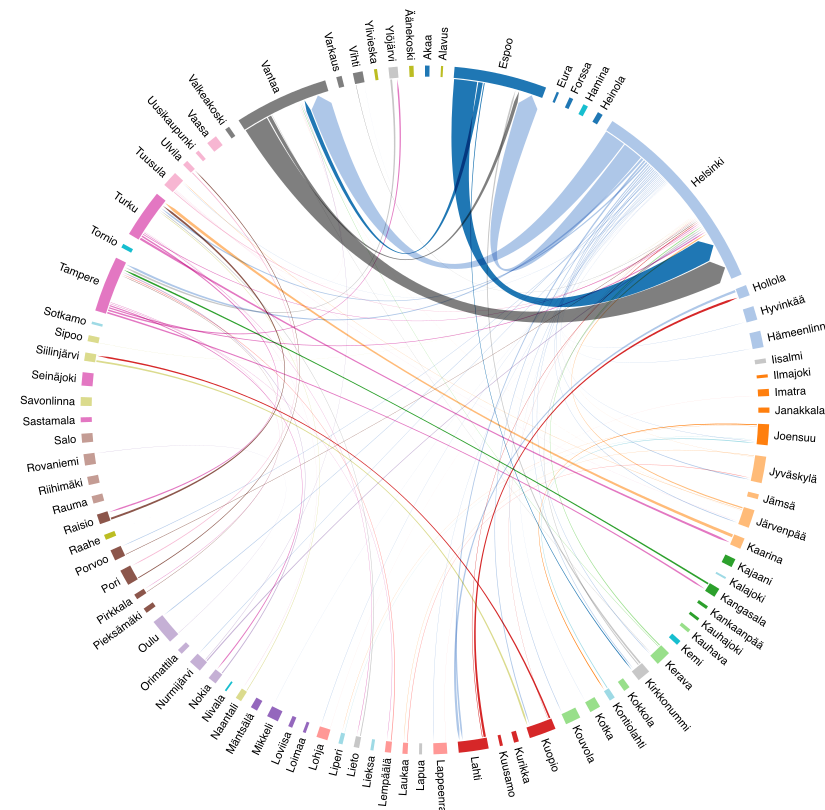
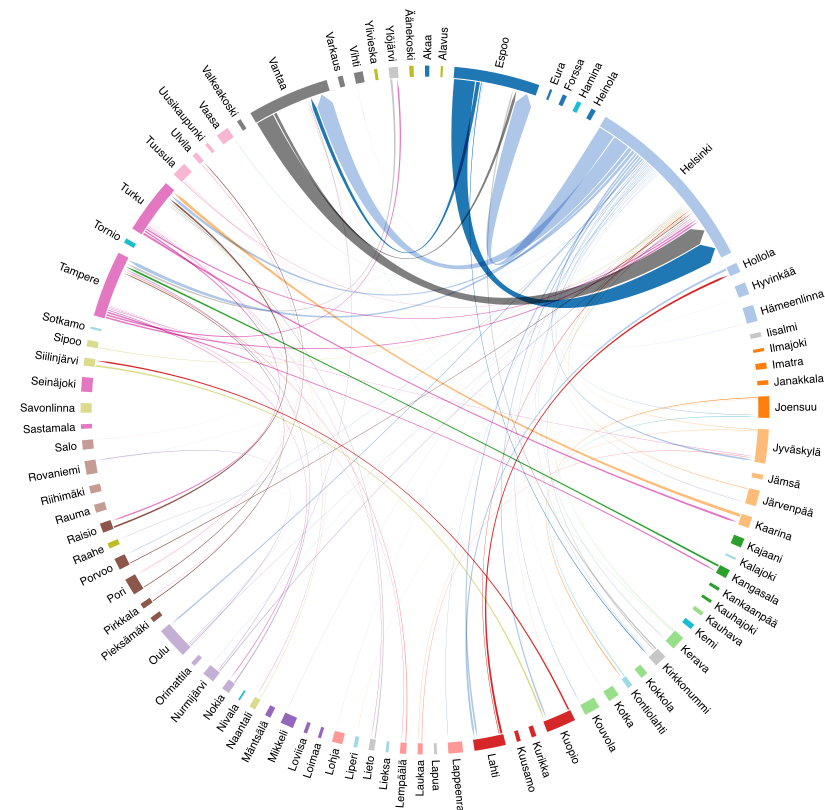
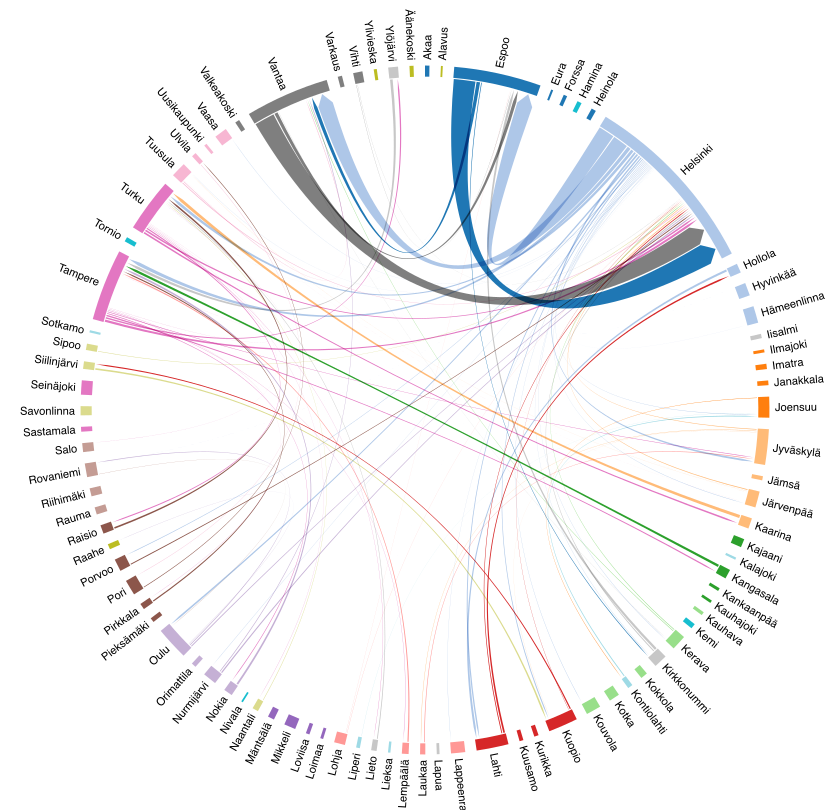
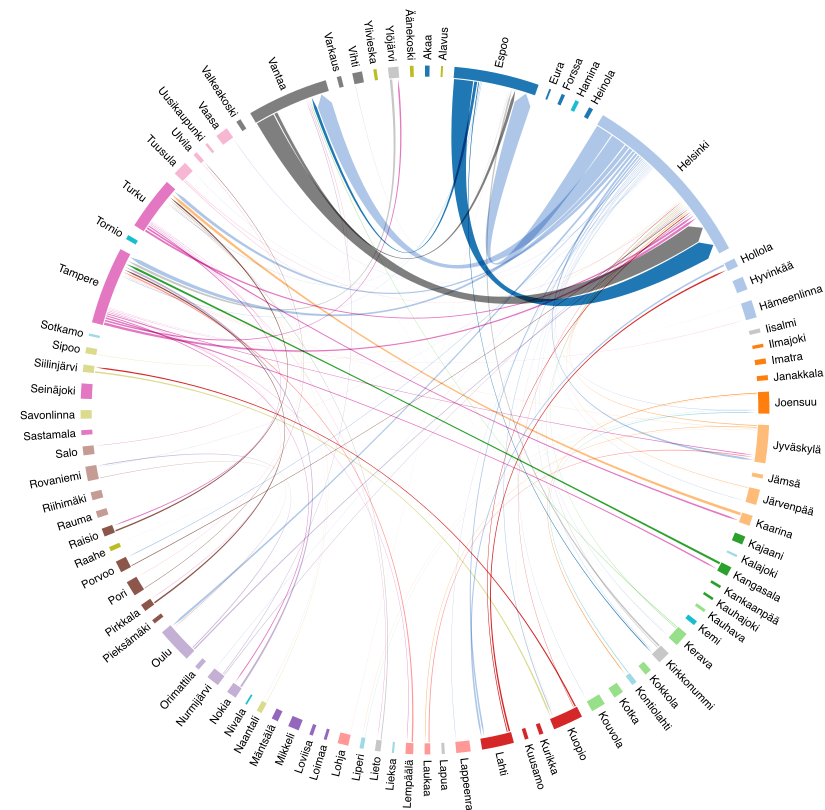
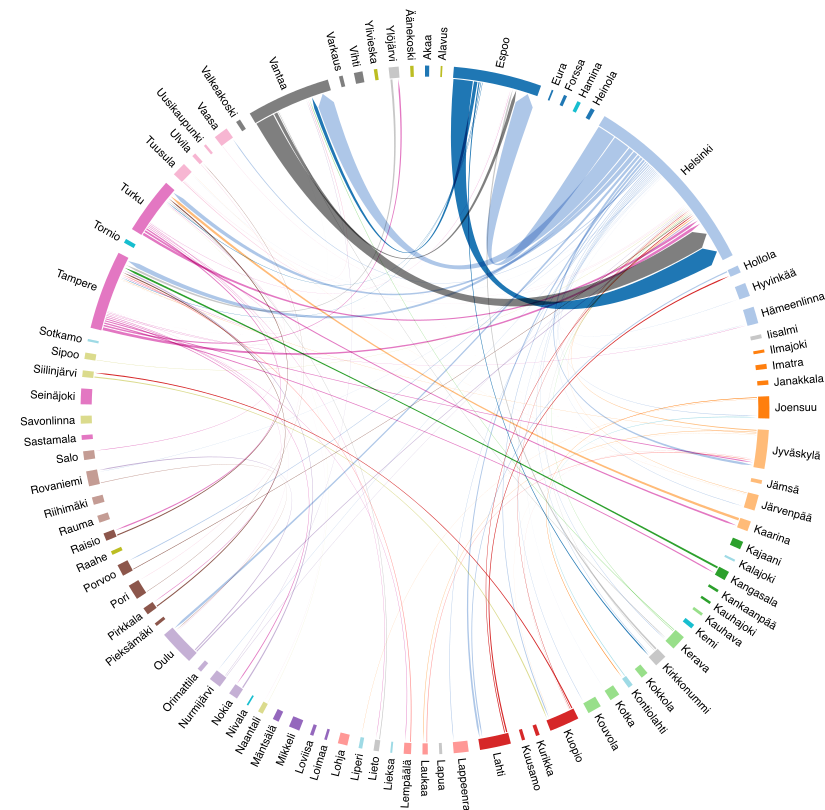
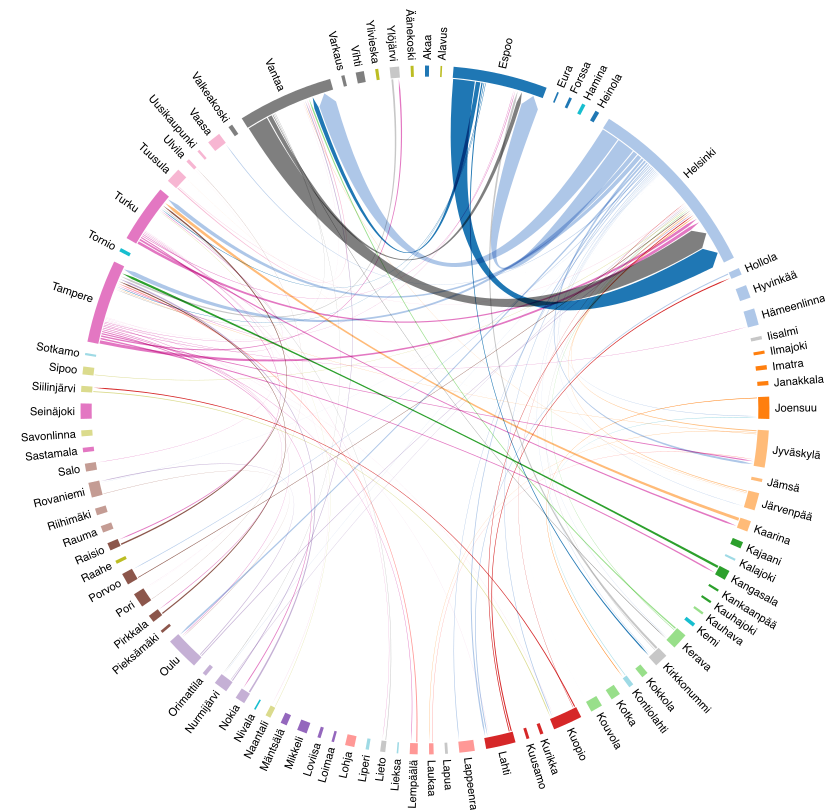

In [111]:
from IPython.display import HTML
import base64

html = '''
<style>
    .img-box {
        border: 2px solid #333;
        padding: 5px;
        margin: 1px;
        text-align: center;
        background: #f8f9fa;
    }
    .subtitle {
        font-weight: bold;
        margin: 10px 0;
    }
</style>

<h3 style="text-align:center">Migration Between Municipalities 1990-2024</h1>
<div style="display: grid; grid-template-columns: repeat(2, 1fr); gap: 20px;">
'''
#<img src="{img_data.hex()}" style="width:100%;">
for i, (img_data, title) in enumerate(zip(processed_images, 
                                          [i.split('_')[-1][:-4] for i in images])):
    
    base64_img = base64.b64encode(img_data).decode('utf-8')
    
    html += f'''
    <div class="img-box">
        <div class="subtitle">{title}</div>
        <img src="data:image/png;base64,{base64_img}" 
             style="max-width:100%; height:500px; object-fit: contain;">
        <div style="color:gray">({chr(65+i)})</div>
    </div>
    '''
    
html += '</div>'
display(HTML(html))


In [112]:
#with open("images/chord_full.html", "w") as f:
#    f.write(html)

### Take the difference between first and later year bins

In [113]:
flow_data = flow_data.sort_values('bin')

reference = (
    flow_data.groupby(['Arrival', 'Departure'])
    .first()['Migration']
    .rename('reference_migratees')
)
merged = flow_data.merge(
    reference,
    how='left',
    on=['Arrival', 'Departure']
)

merged['diff'] = merged['Migration'] - merged['reference_migratees']

In [114]:
# Initialize
bin = _bins[1]
print(bin)

d3 = D3Blocks(chart='Chord', frame=False)

###
result_swapped = merged[["Arrival", "Departure", "diff", "bin"]].copy()

# Identify negative difference rows
neg_mask = result_swapped['diff'] < 0

# Swap municipalities for negative differences
result_swapped.loc[neg_mask, ['Arrival', 'Departure']] = (
    result_swapped.loc[neg_mask, ['Departure', 'Arrival']].values
)

# Convert differences to absolute values
result_swapped['diff'] = result_swapped['diff'].abs()

# Final cleaned result
final_result = result_swapped.sort_values(
    ['Arrival', 'Departure', 'bin']
)

final_aggregated = (
    final_result.groupby([
        'Arrival',
        'Departure',
        'bin'
    ])['diff'].sum()
    .reset_index()
    .sort_values(['Arrival', 'bin'])
)
###

# df = merged[["Arrival", "Departure", "diff", "bin"]]
df = final_aggregated
df.columns = ["source", "target", "bin", "weight"]
df = df.loc[df["bin"] == bin, ["source", "target", "weight"]]

d3.set_node_properties(df, opacity=1.0, cmap='tab20')

if node_color_map is None:  
    node_color_map = {node: props['color'] for node, props in d3.node_properties.items()}
else:
    # set colormap to match
    for node_name, color in node_color_map.items():
        d3.node_properties.get(node_name)['color'] = color

d3.set_edge_properties(df, color='source', opacity='source')

# Show the chart
# d3.show()

[d3blocks] >INFO> Cleaning edge_properties and config parameters..
[d3blocks] >INFO> Initializing [Chord]
[d3blocks] >INFO> filepath is set to [/var/folders/v8/zpztjcs96259p0s5wtn62d2r0000gp/T/d3blocks/chord.html]
[d3blocks] >INFO> Node properties are set.
[d3blocks] >INFO> Edge properties are set.


(1996.0, 2001.0]


In [115]:

# Process all images
images = [('images/svgs_diff/chord_diff_' + bin +'.png') for bin in 
          ['1996-2001', '2001-2006', 
           '2006-2012', '2012-2018', '2018-2023']]

processed_images = [process_image(img, i) for (i, img) in enumerate(images)]



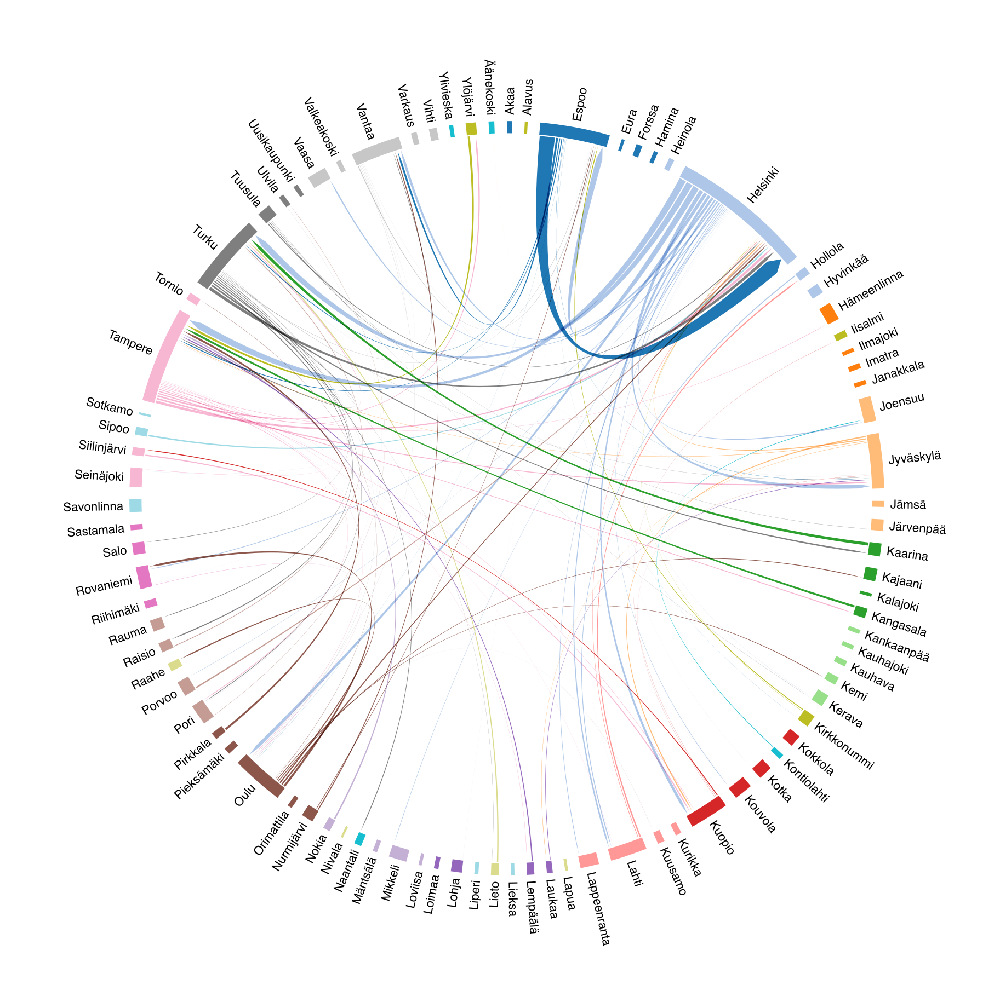
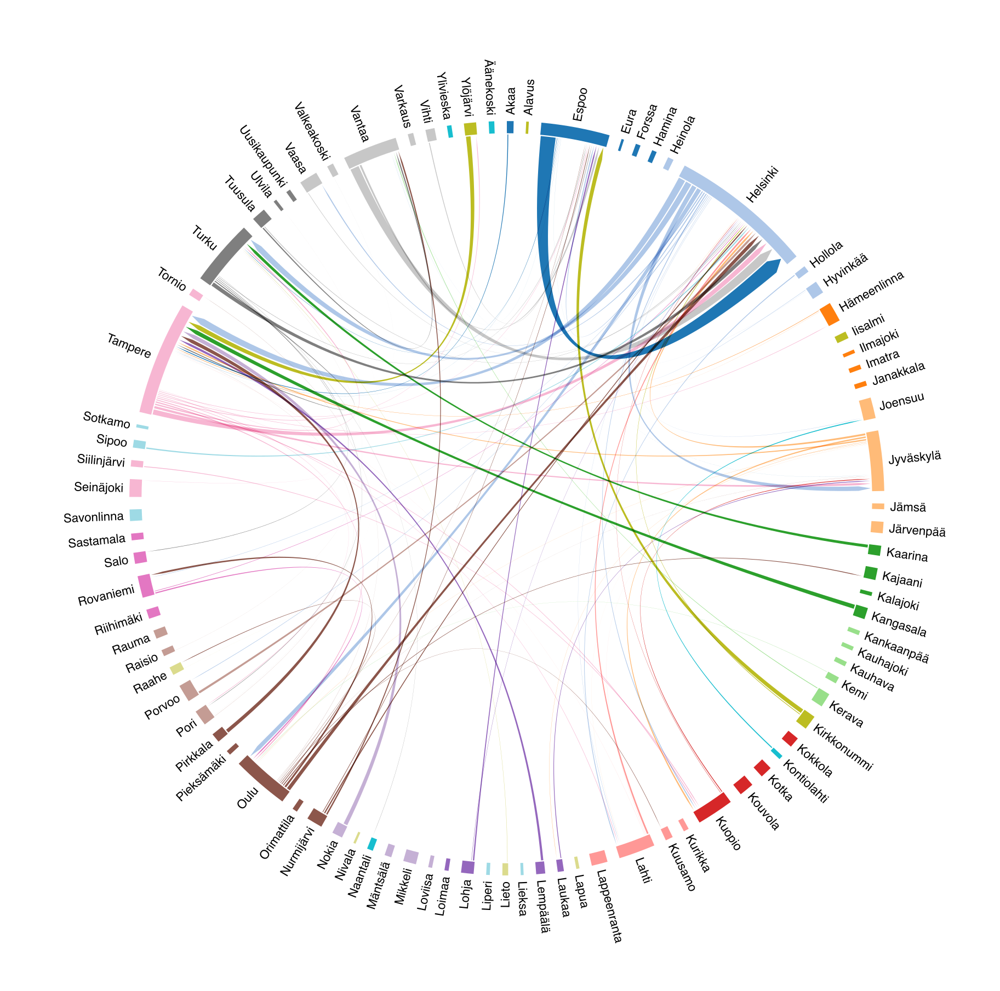
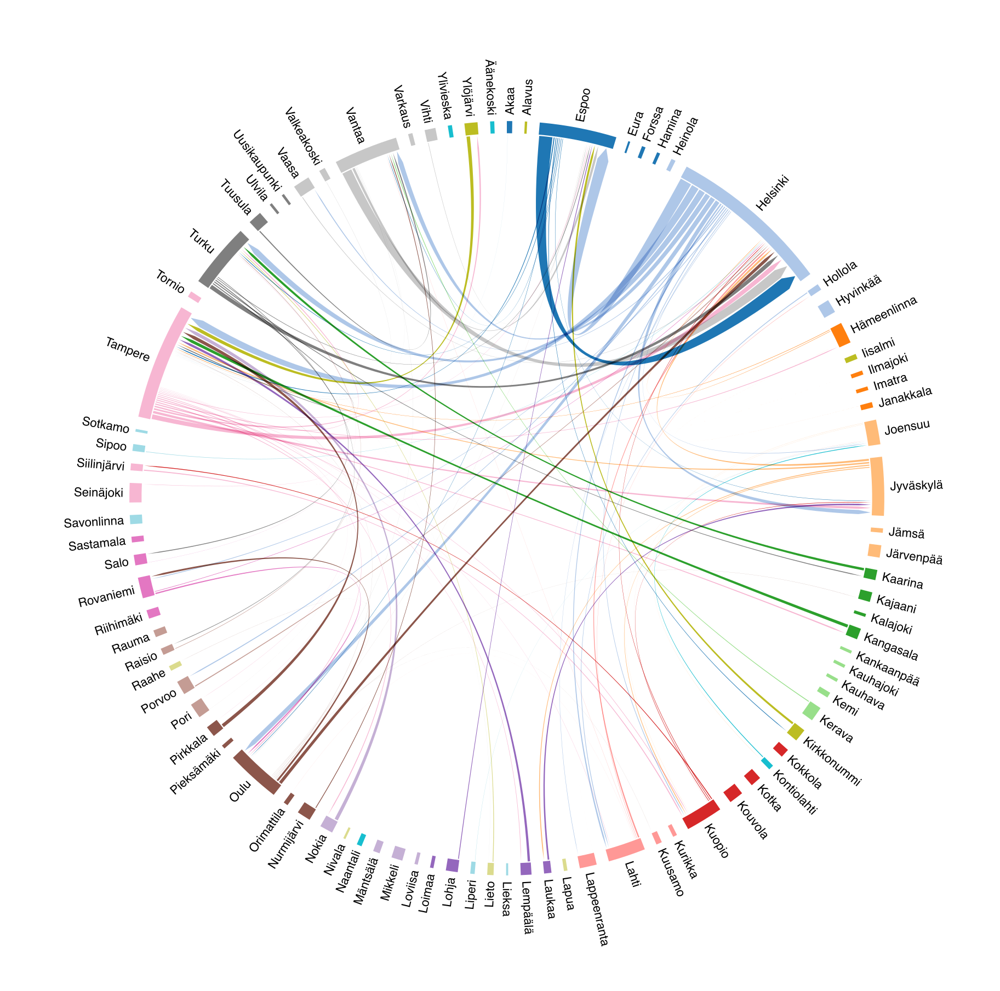
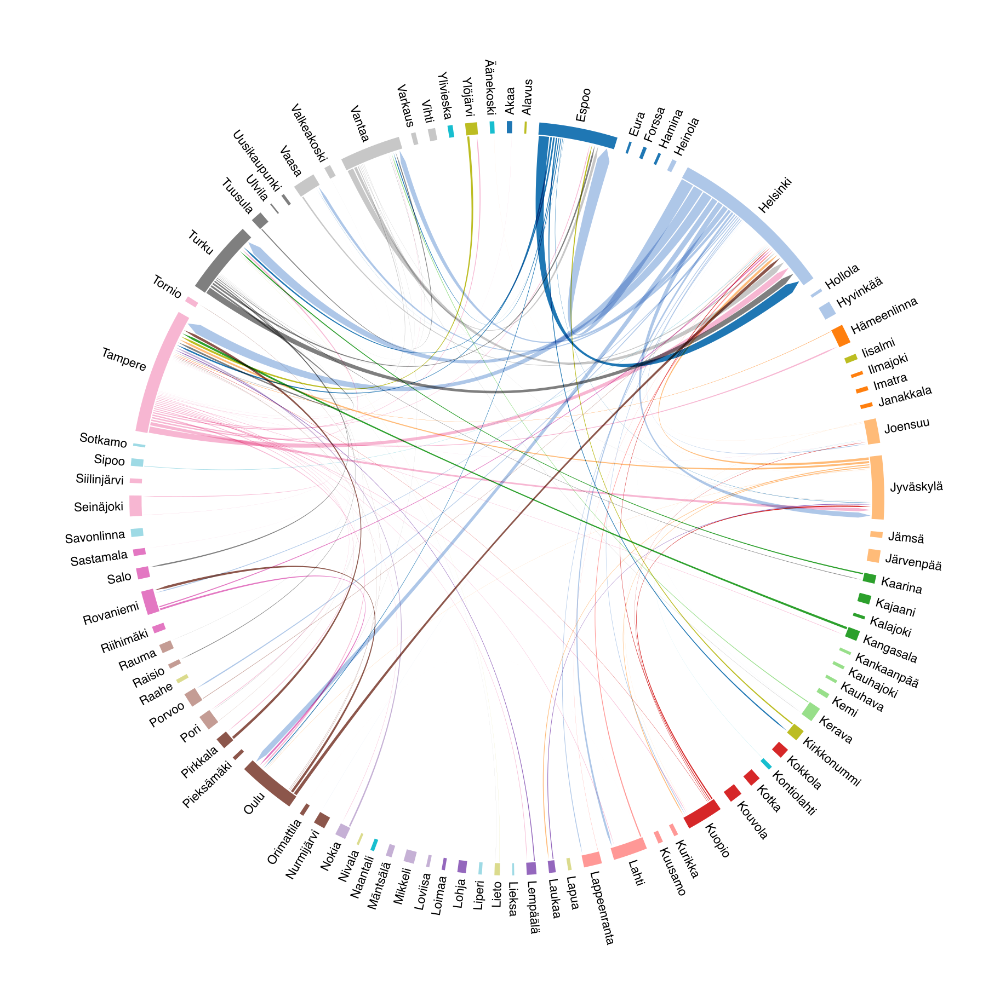
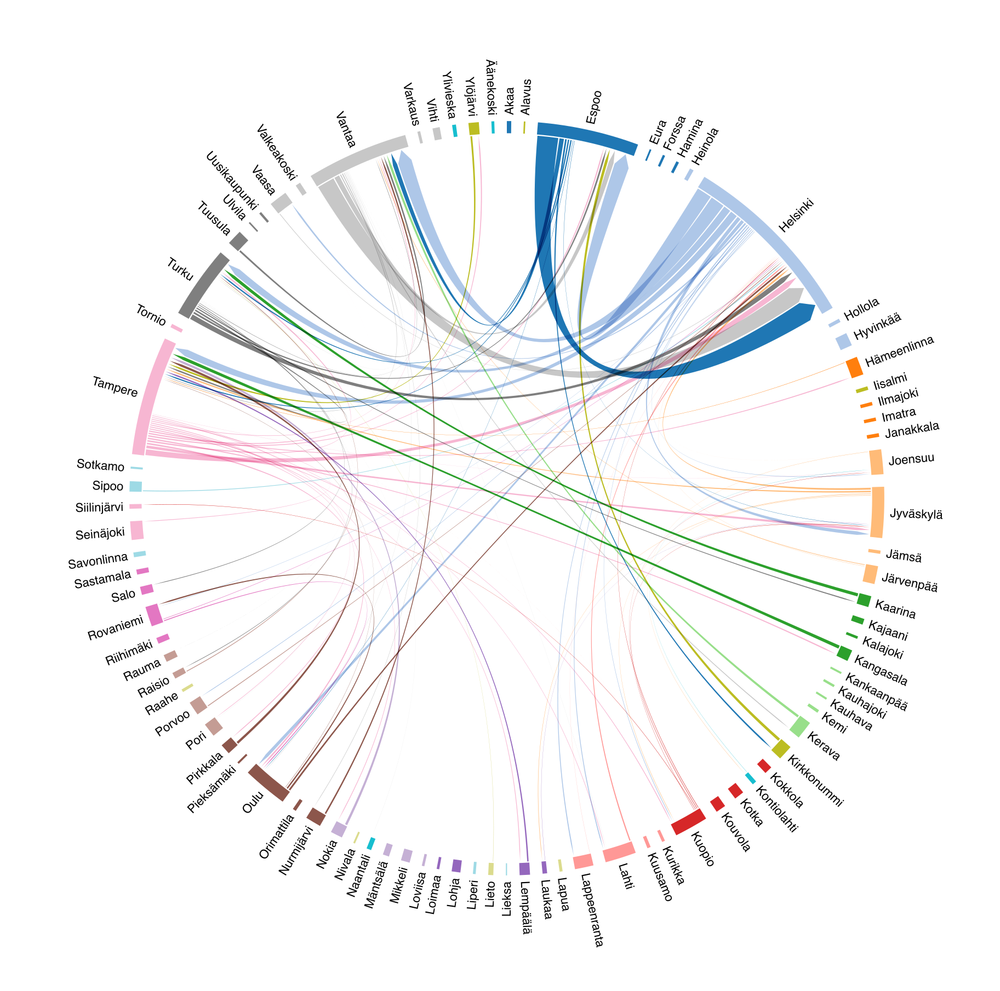

In [116]:

html = '''
<style>
    .img-box {
        border: 2px solid #333;
        padding: 5px;
        margin: 1px;
        text-align: center;
        background: #f8f9fa;
    }
    .subtitle {
        font-weight: bold;
        margin: 10px 0;
    }
</style>

<h3 style="text-align:center">Migration Between Municipalities 1996-2024 compared to 1990-1996</h1>
<div style="display: grid; grid-template-columns: repeat(2, 1fr); gap: 20px;">
'''
#<img src="{img_data.hex()}" style="width:100%;">
for i, (img_data, title) in enumerate(zip(processed_images, 
                                          [i.split('_')[-1][:-4] for i in images])):
    
    base64_img = base64.b64encode(img_data).decode('utf-8')
    
    html += f'''
    <div class="img-box">
        <div class="subtitle">{title}</div>
        <img src="data:image/png;base64,{base64_img}" 
             style="max-width:100%; height:500px; object-fit: contain;">
        <div style="color:gray">({chr(65+i)})</div>
    </div>
    '''
    
html += '</div>'
display(HTML(html))


In [117]:
#with open("images/chord_diffs.html", "w") as f:
#    f.write(html)

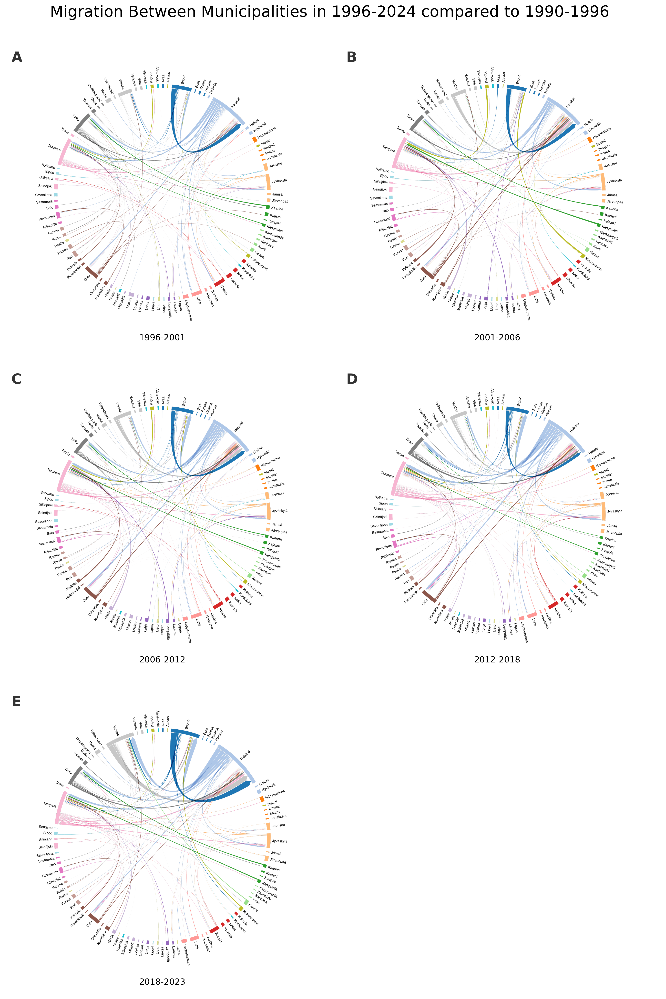

In [118]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as patches

plt.close()

# get the first to determine figsize
dpi = 300  # 
height, width = mpimg.imread(images[0]).shape[:2]
# dpi = 300
# figsize=(width/dpi, height/dpi), dpi=dpi)  # figsize=(nrows, 3*ncols)


# Example input
png_files = images
subtitles = [i.split('_')[-1][:-4] for i in images]
panel_labels = [chr(65+i) for i in range(len(png_files))]
nrows, ncols = 3, 2

# fig, axes = plt.subplots(nrows, ncols, figsize=(nrows, 2*ncols))
# fig, axes = plt.subplots(nrows, ncols, figsize=(width/dpi * 0.65, height/dpi), dpi=dpi)
fig, axes = plt.subplots(nrows, ncols, figsize=(width/dpi * 2, height/dpi * 3), dpi=dpi)
axes = axes.flatten()

for idx, (ax, img_path, label, subtitle) in enumerate(zip(axes, png_files, panel_labels, subtitles)):
    img = mpimg.imread(img_path)
    ax.imshow(img)
    ax.axis('off')
    # Letter label in upper left
    ax.text(0.02, 0.95, label, transform=ax.transAxes, 
            fontsize=20, fontweight='bold', va='top', ha='left', 
            alpha=0.8,
            bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
    # Subtitle 
    ax.text(0.5, 0.05, subtitle, transform=ax.transAxes, 
            fontsize=12, va='top', ha='center', color='black', 
            bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
    # Border
    # rect = patches.Rectangle(
    #     (0, 0), 1, 1, transform=ax.transAxes,
    #     linewidth=3, edgecolor='black', facecolor='none', zorder=10
    # )
    # ax.add_patch(rect)

for ax in axes[len(png_files):]:
    ax.axis('off')  # Hide empty subplots

# Reduce space between panels
plt.subplots_adjust(left=0.0, right=1.0, top=1.0, bottom=0.0, wspace=0.01, hspace=0.01)

# Add a global title
fig.suptitle('Migration Between Municipalities in 1996-2024 compared to 1990-1996', fontsize=22)

# Add a global caption below all panels
# fig.text(0.5, 0.01, 'Global caption describing the whole figure.', ha='center', fontsize=18)

plt.tight_layout(rect=[0, 0, 1, 0.98])  # Adjust layout to fit title
# plt.tight_layout()
# plt.savefig('diff_chords.png', dpi=600, bbox_inches='tight')
plt.savefig('diff_chords_lower-res.png', dpi=150, bbox_inches='tight')
plt.show()
